In [1]:
import numpy as np
import pandas as pd
import pylab as plt
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

Matplotlib created a temporary config/cache directory at /tmp/matplotlib-_8663u6d because the default path (/home/jjayme/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:
from ABM import *
from utils import *

## Model Parameters

1. `no_agents` - the number of agents or nodes in the network
2. `ptrans` - probability of transmission of disinformation
3. `infection_period` - The length of infection, wherein an infected node or agent will actively spread the disinformation to its neighbors.
5. `m` - a parameter in the barabasi_albert_graph in NetworkX which is defined as the number of edges to attach from a new node to existing nodes.
6. `seed` - The seed used for the random number generator. This parameter is fed into the barabasi_albert_graph in NetworkX. 
7. `target_hubs` - If set to *True*, the hubs of the network are assigned as the initial Infected nodes, otherwise random nodes will be chosen.
8. `p_infect` - probability of each agent to be infected at the start of the simulation

In [3]:
# Set parameters fixed for all scenarios
np.random.seed = 0
no_agents = 100
n_simulations = 100
total_steps = 50

# Changing Path Length

We varied the characteristic path length of our simulated social network by changing the parameter `m` in the Barabási-Albert network model. In our first simulation we set `m` = 2 and `m` = 10.

## m = 2

time steps =  0


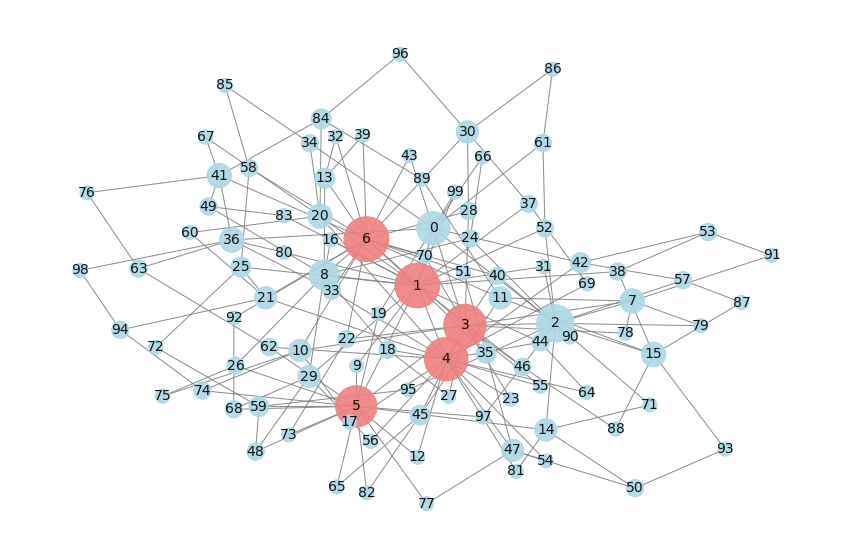

time steps =  1


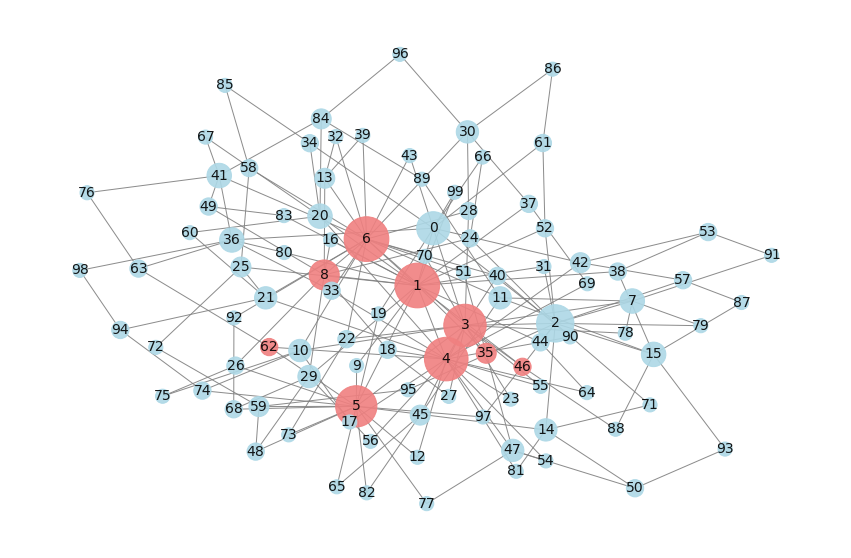

time steps =  2


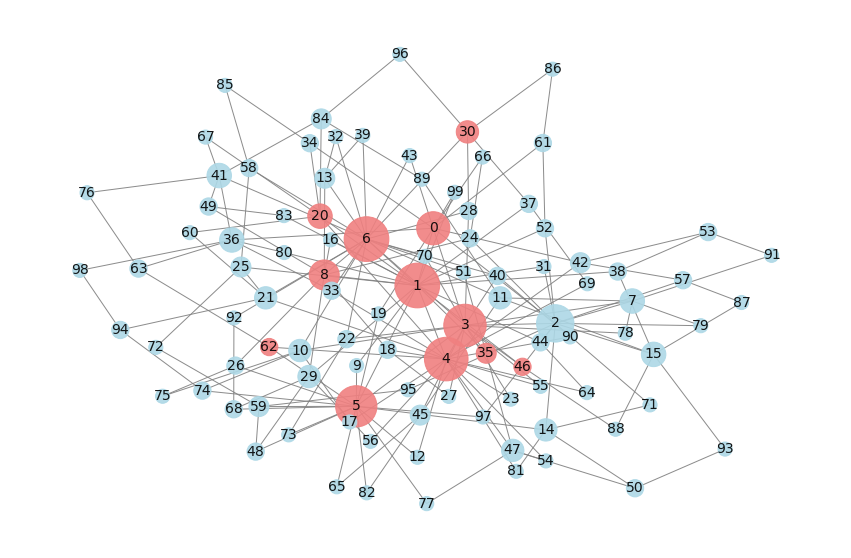

time steps =  3


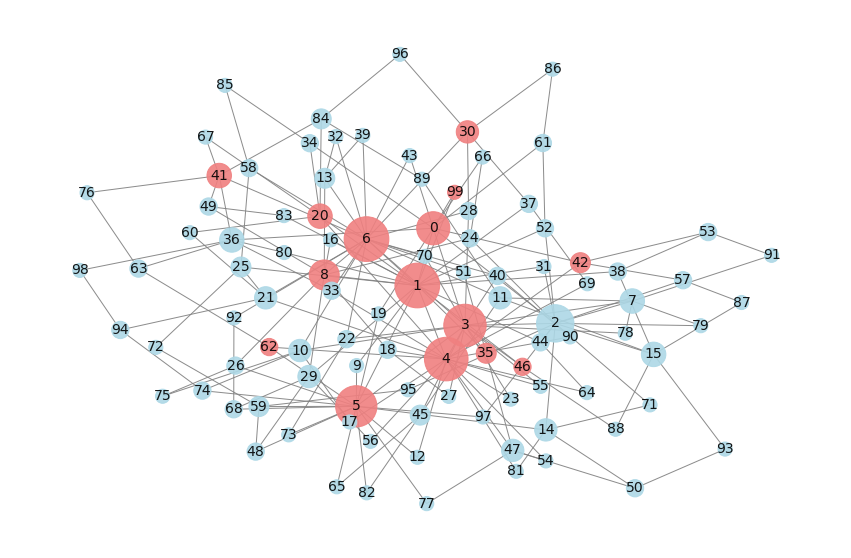

time steps =  4


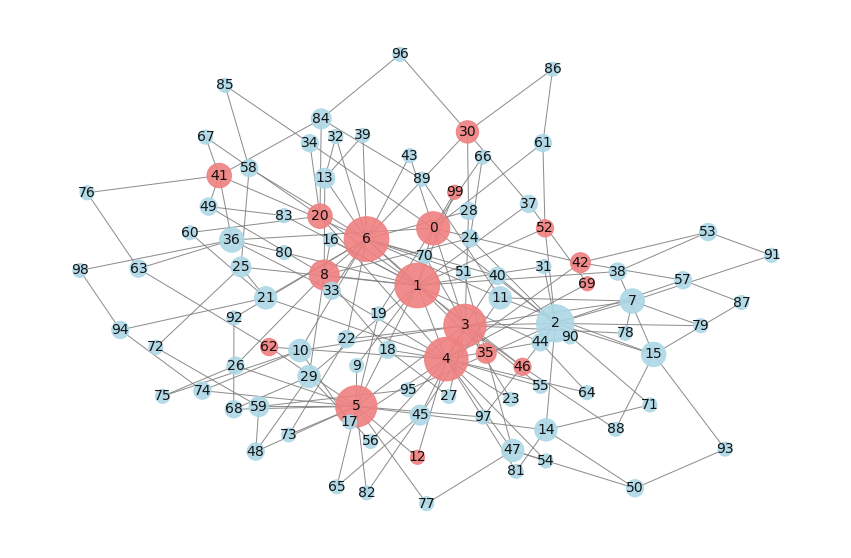

time steps =  5


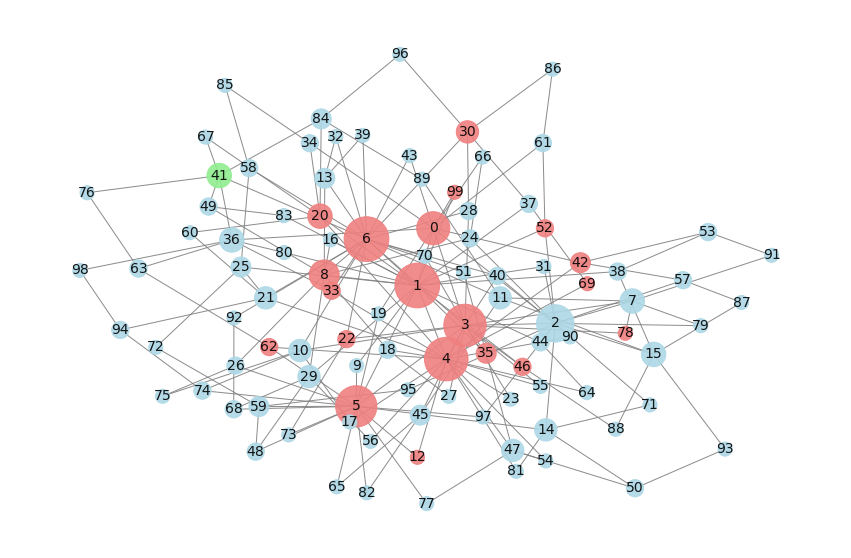

time steps =  10


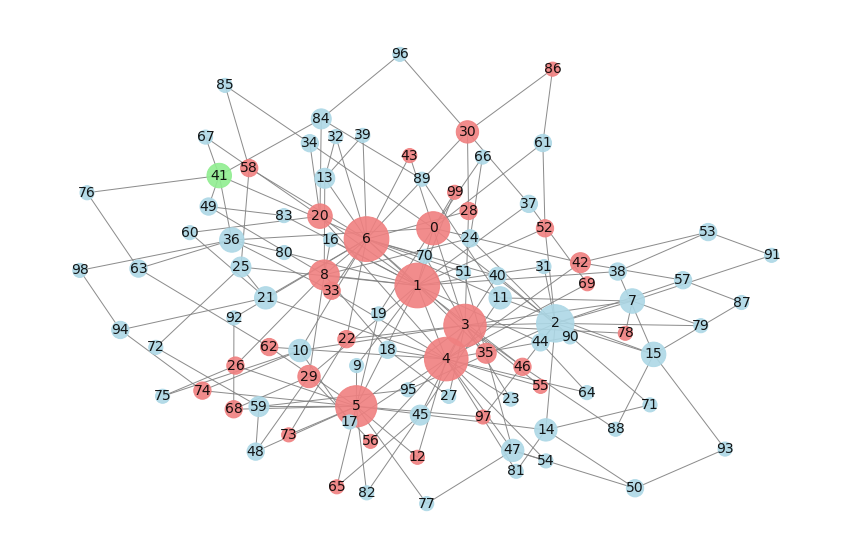

time steps =  20


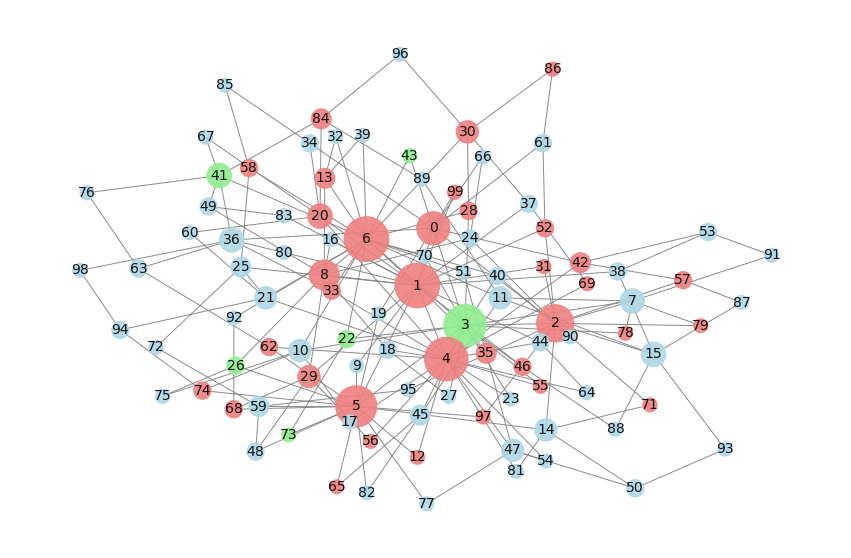

time steps =  30


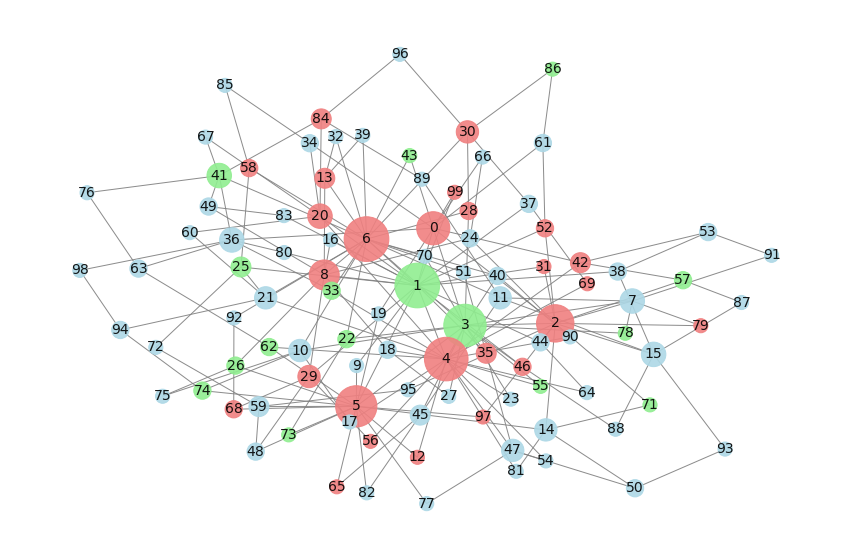

time steps =  40


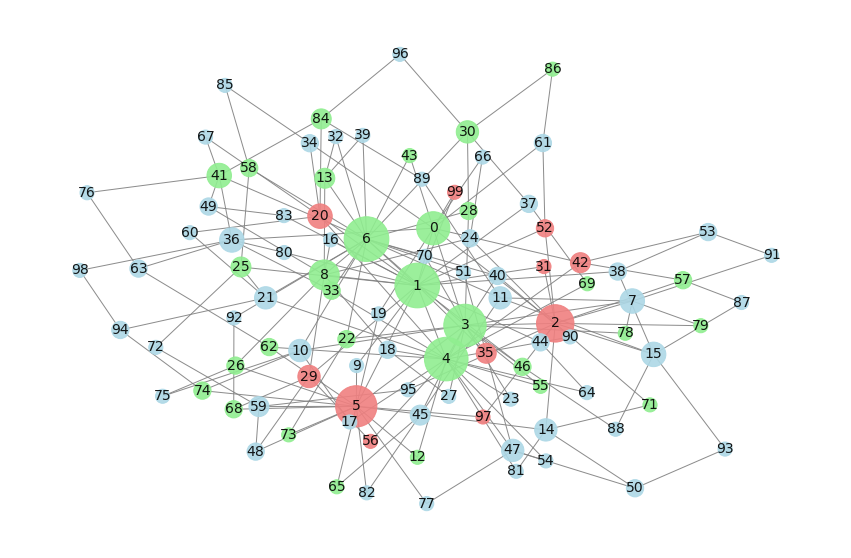

In [4]:
model = NetworkInfectionModel(no_agents, ptrans=0.05,
                                      infection_period= 30, 
                                      infection_sd=10, seed=143,
                                      m=2, target_hubs=True)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_network(model, fig,layout='spiral')
        plt.savefig(f"figures_scenario1/m=2_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [5]:
describe_network(model)

Average clustering coefficient: 0.15479098490089202
Characteristic path length: 2.9965656565656564


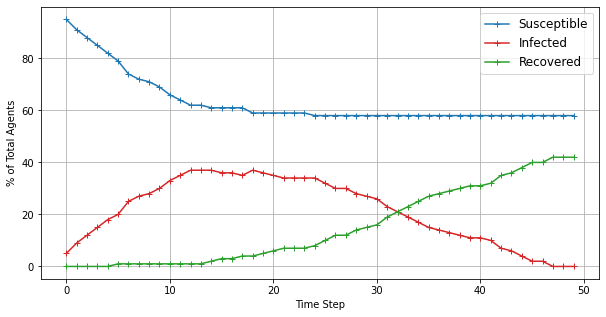

In [6]:
plot_SIR(model,no_agents,"figures_scenario1/SIR_m=2")

## m = 10

time steps =  0


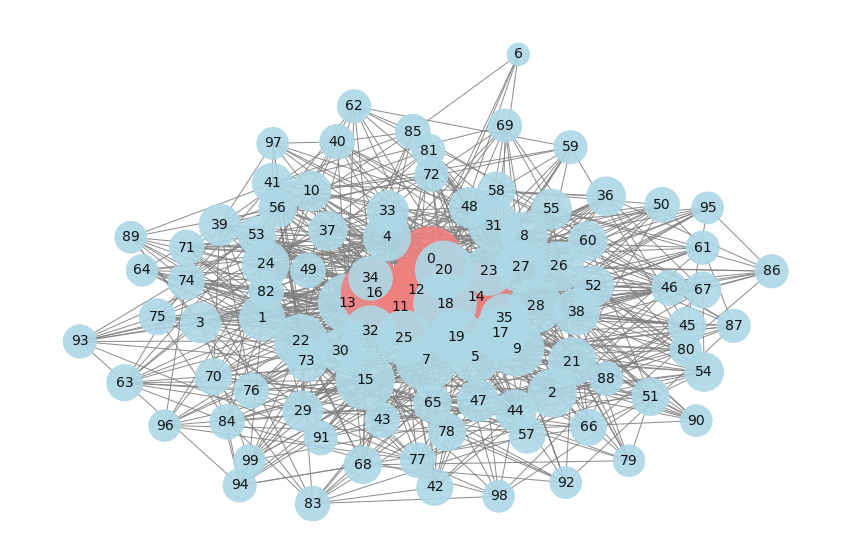

time steps =  1


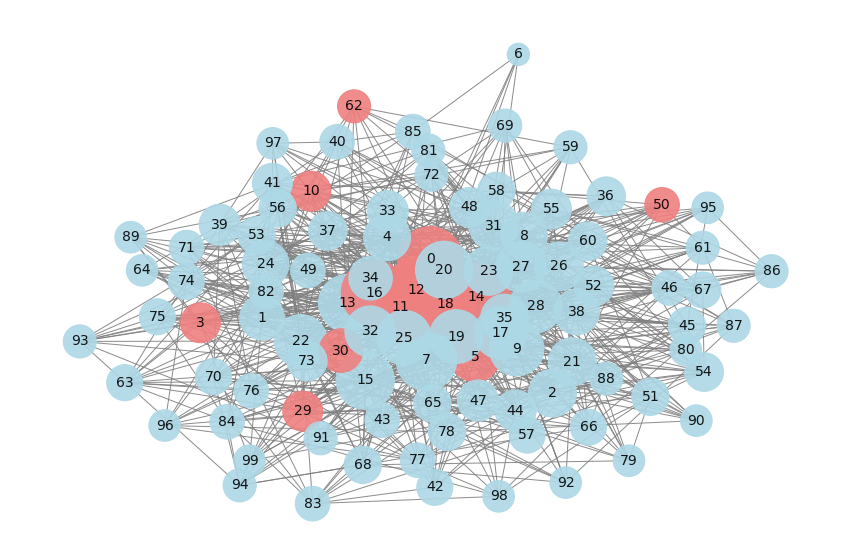

time steps =  2


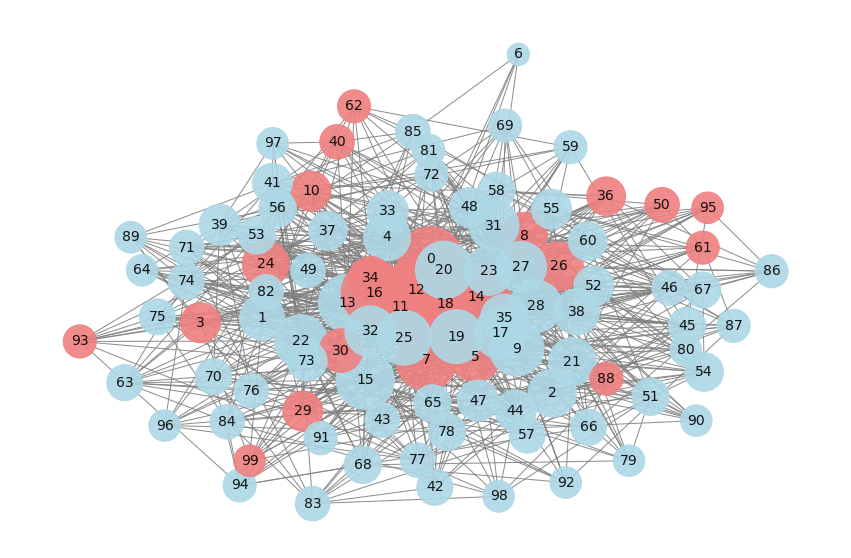

time steps =  3


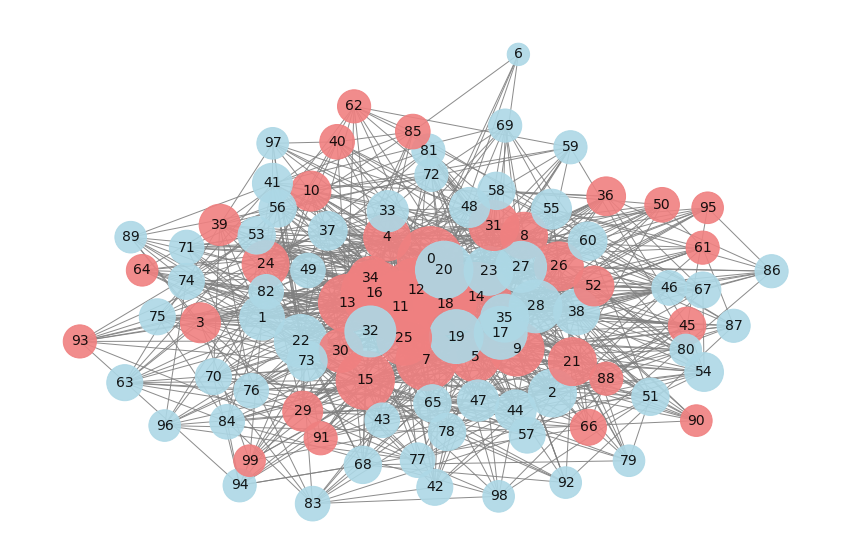

time steps =  4


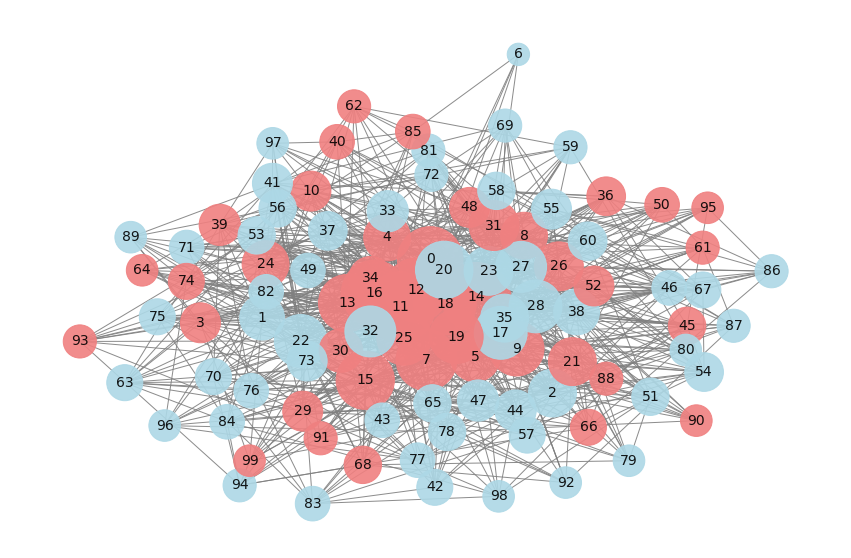

time steps =  5


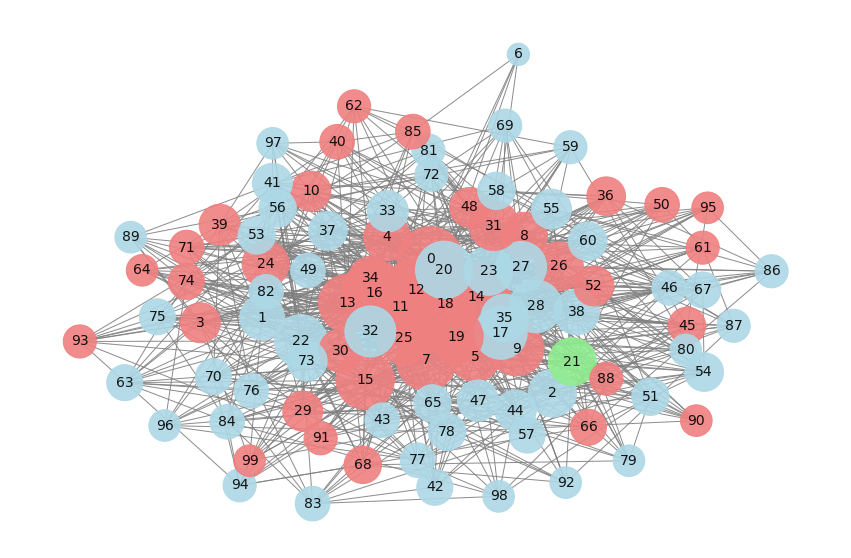

time steps =  10


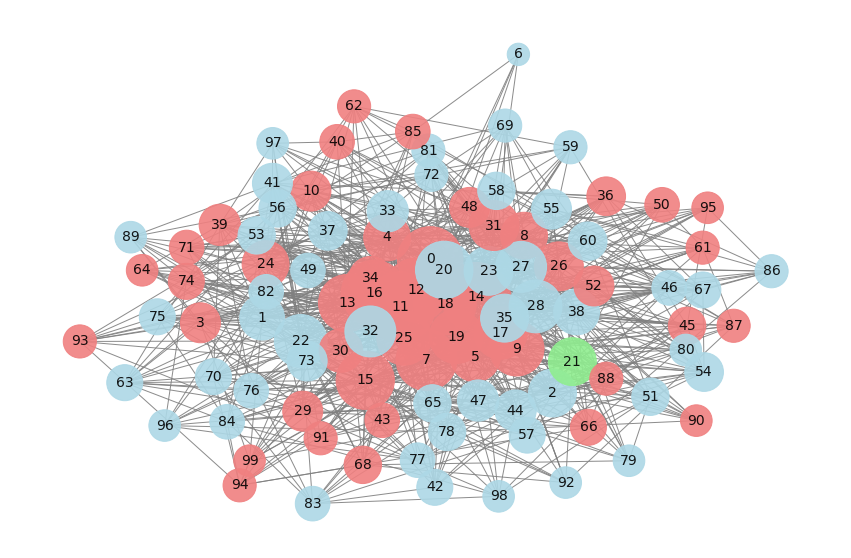

time steps =  20


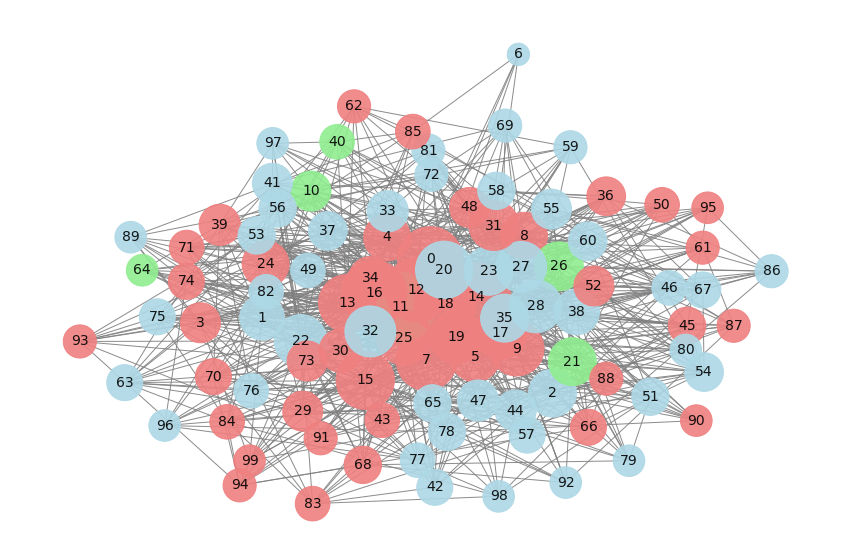

time steps =  30


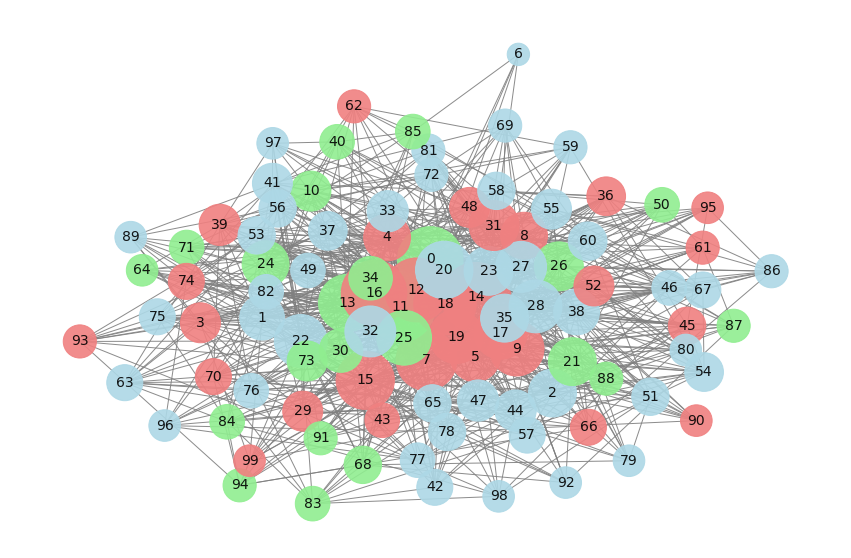

time steps =  40


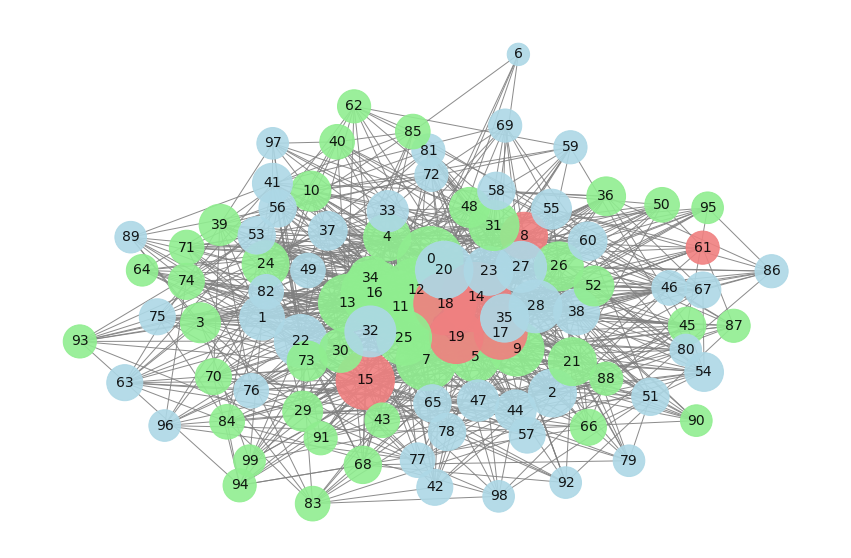

In [7]:
model = NetworkInfectionModel(no_agents, ptrans=0.05,
                                      infection_period= 30, 
                                      infection_sd=10, seed=143,
                                      m=10, target_hubs=True)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_network(model, fig,layout='spiral')
        plt.savefig(f"figures_scenario1/m=10_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [8]:
describe_network(model)

Average clustering coefficient: 0.28081415880712873
Characteristic path length: 1.8587878787878789


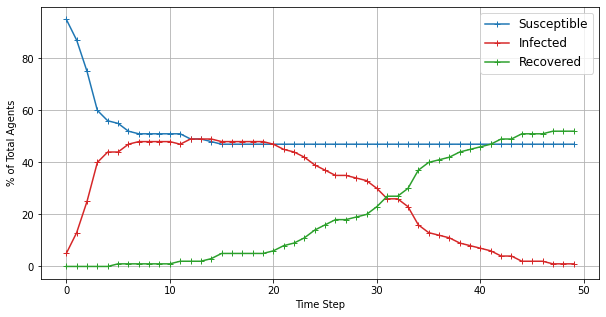

In [9]:
plot_SIR(model,no_agents,"figures_scenario1/SIR_m=10")

## Making 100 Simulations

In [10]:
def simulate_changing_pathL(n_simulations=n_simulations,
                            total_steps=total_steps,
                            m=4, target_hubs=True):
    """Return the average clustering coefficient, average path length,
    average of the total nodes infected and average time step
    when transmission plateaus."""
    
    cc = []
    path_length = []
    max_nodes_infected = []
    last_step_infected = []

    for i in range(n_simulations):
        model = NetworkInfectionModel(no_agents, ptrans=0.05,
                                      infection_period= 30, 
                                      infection_sd=10, seed=i,
                                      m=m, target_hubs=target_hubs)
        for i in range(total_steps):
            model.step()
            
        spread_df = model.datacollector.get_model_vars_dataframe()
        cc.append(nx.average_clustering(model.G))
        path_length.append(nx.average_shortest_path_length(model.G))
        max_nodes_infected.append(no_agents - spread_df['Susceptible'].min())
        last_step_infected.append(spread_df.loc[spread_df['Susceptible'] ==
                                    spread_df['Susceptible'].min()].index[0])

    cc_mean = np.mean(cc)
    pathL_mean = np.mean(path_length)
    average_infected_nodes = np.mean(max_nodes_infected)
    average_last_step = np.mean(last_step_infected)
    
    return cc_mean, pathL_mean, average_infected_nodes, average_last_step

cc_list = []
pathL_list = []
infected_nodes_list = []
last_step_list = []

for m in np.arange(3, 18, 3):
    (cc_mean, pathL_mean,
     average_infected_nodes, average_last_step) = simulate_changing_pathL(
                                                    n_simulations, total_steps,
                                                    m=m, target_hubs=True)
    cc_list.append(cc_mean)
    pathL_list.append(pathL_mean)
    infected_nodes_list.append(average_infected_nodes)
    last_step_list.append(average_last_step)

In [11]:
df = pd.DataFrame()
df['m'] = np.arange(3, 18, 3)
df['Characteristic Path length'] = [round(i, 2) for i in pathL_list]
df['Ave. Clustering Coefficient'] = [round(i, 2) for i in cc_list]
df['Total Infected Agents'] = [round(i) for i in infected_nodes_list]
df['Time step of Last Infection'] = [round(i) for i in last_step_list]
df

,m,Characteristic Path length,Ave. Clustering Coefficient,Total Infected Agents,Time step of Last Infection
0,3,2.58,0.15,49,23
1,6,2.11,0.21,53,14
2,9,1.90,0.27,55,11
3,12,1.80,0.32,56,8
4,15,1.74,0.36,57,7


**Insights**

We varied the characteristic path length of our Barabasi network from 1.74 to 2.59. 

We saw that the network becomes more interconnected as the path length becomes shorter. This was also validated by the increasing clustering coefficient. Because of this, as expected, the total infected agents in the network increases with decreasing path length.

As seen in the table above, with m=15, the characteristic path length is 1.74, and it only takes 7 time steps to infect more than half of the nodes, given the initial infection started in the hubs or central nodes of the network.

# Infection Period

We then explored the effects of infection period to spread of disinformation. We varied the infection period with $15 \pm 5$ vs.  $30 \pm 10$.

## infection_period = 15, infection_sd = 5

time steps =  0


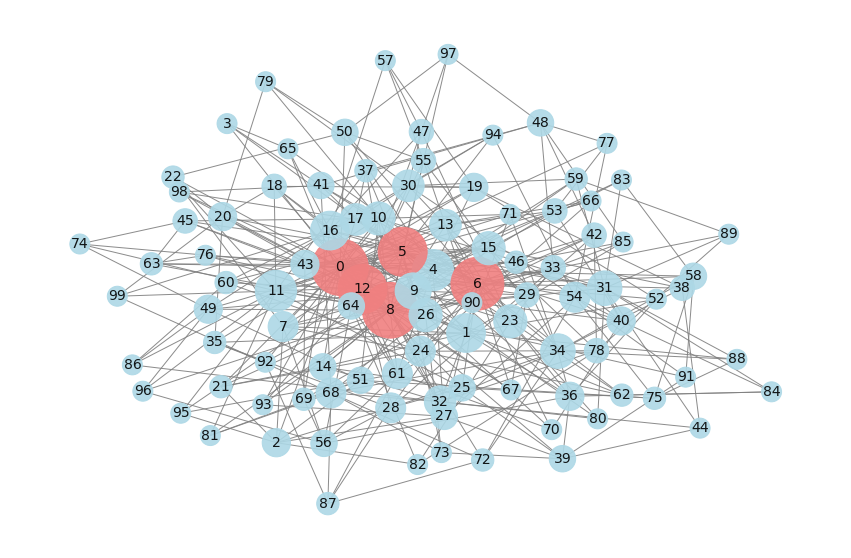

time steps =  1


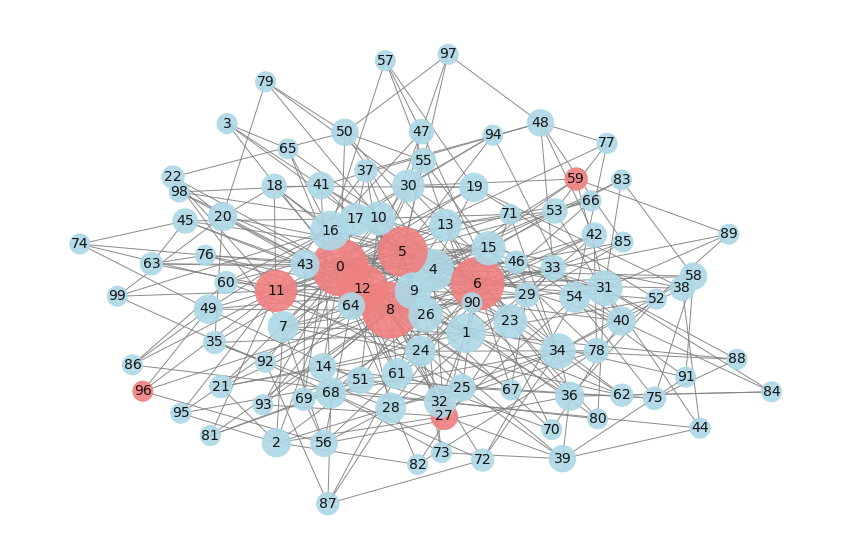

time steps =  2


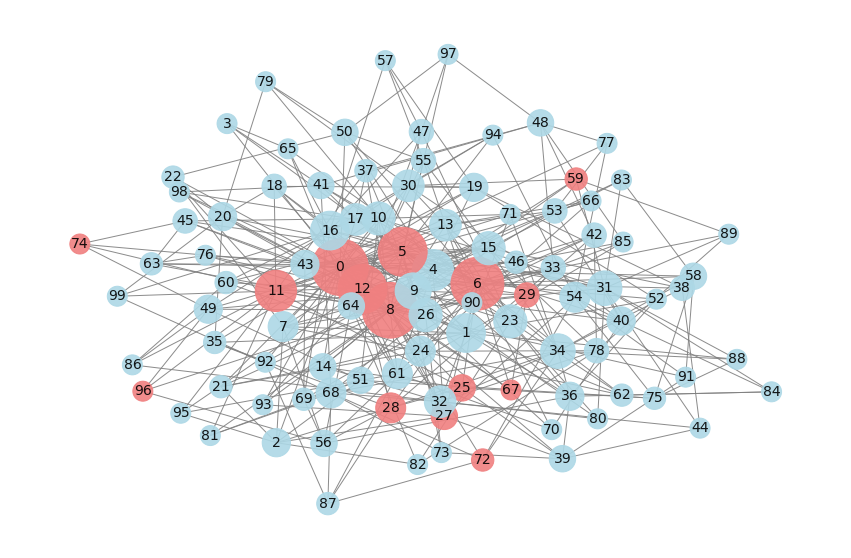

time steps =  3


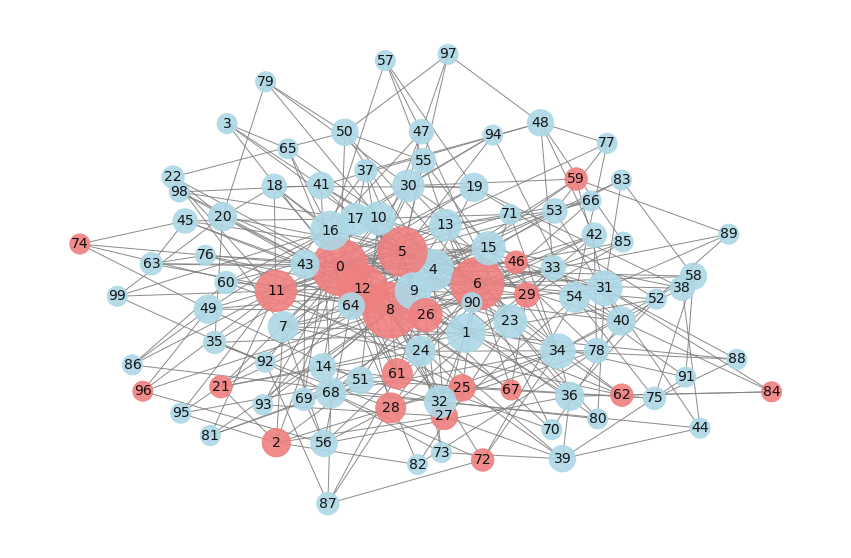

time steps =  4


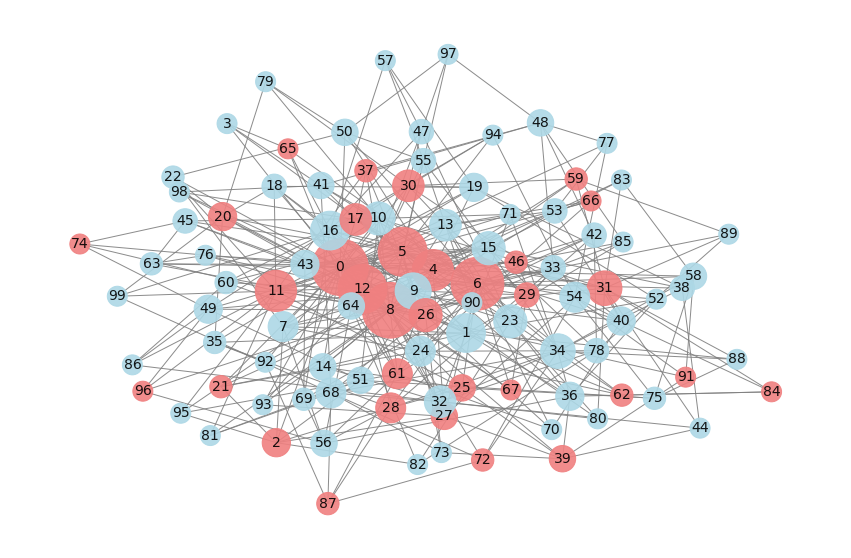

time steps =  5


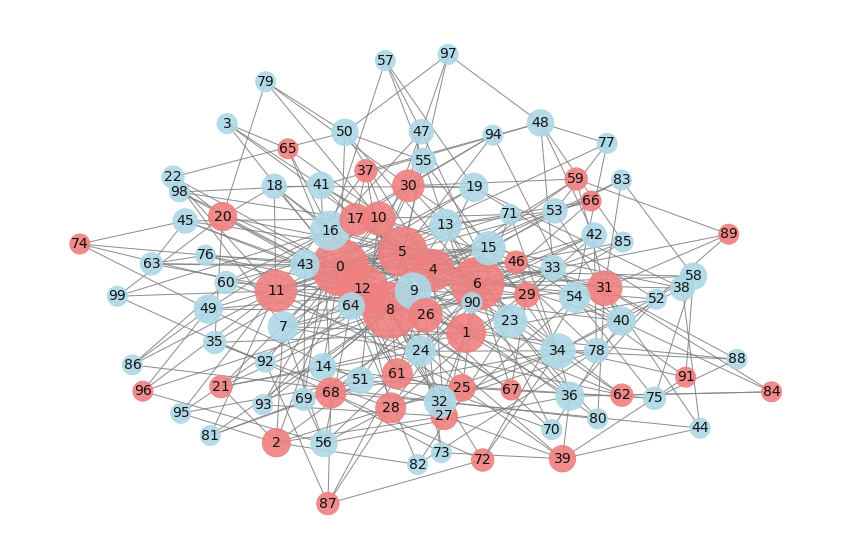

time steps =  10


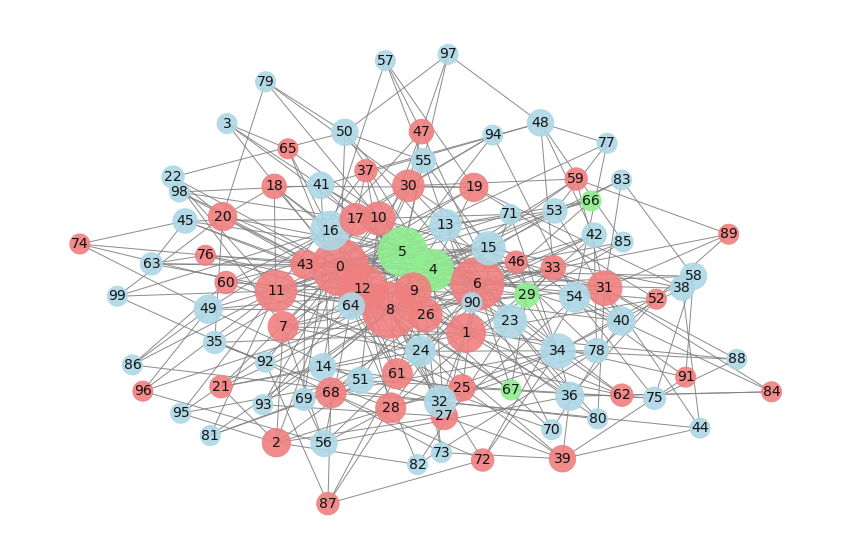

time steps =  20


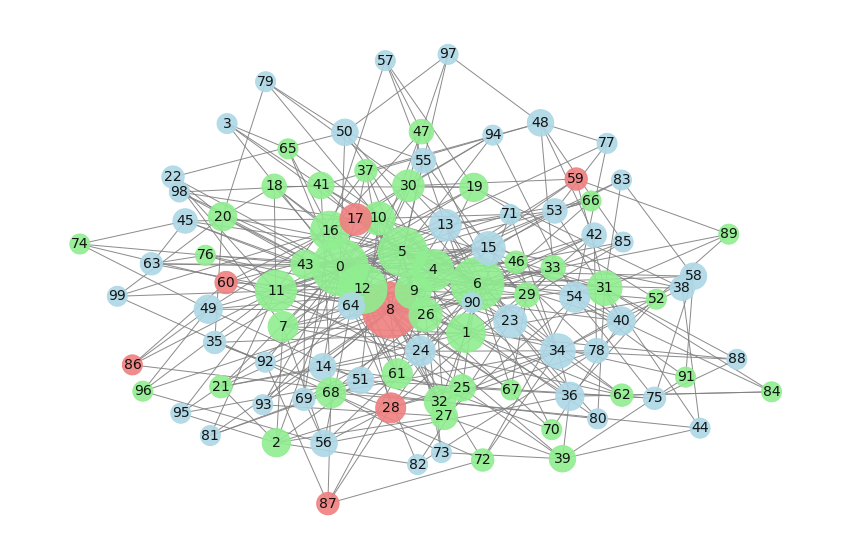

time steps =  30


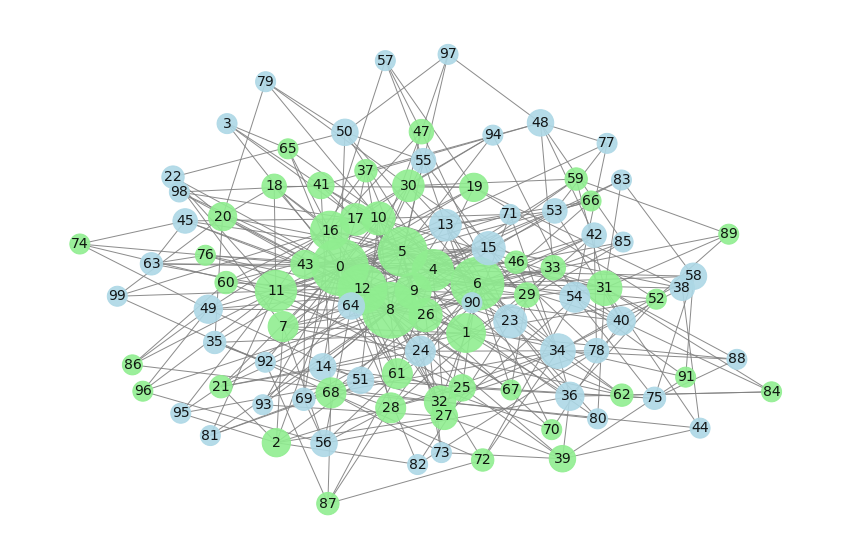

time steps =  40


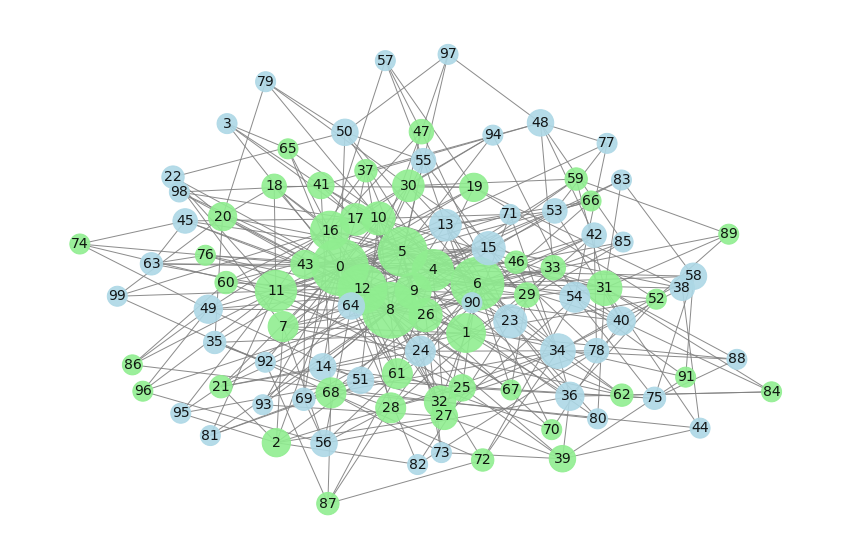

In [12]:
model = NetworkInfectionModel(no_agents, ptrans=0.05,
                              infection_period=15, 
                              infection_sd=5, seed=143,
                              m=4, target_hubs=True)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_network(model, fig,layout='spiral')
        plt.savefig(f"figures_scenario2/infperiod=15_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [13]:
describe_network(model)

Average clustering coefficient: 0.15255633804292118
Characteristic path length: 2.383232323232323


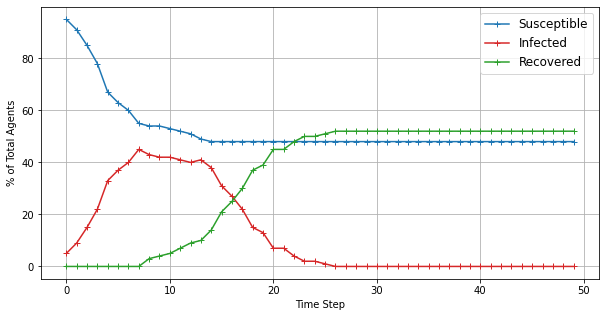

In [14]:
plot_SIR(model,no_agents,"figures_scenario2/SIR_infperiod=15")

## infection_period = 30, infection_sd = 10

time steps =  0


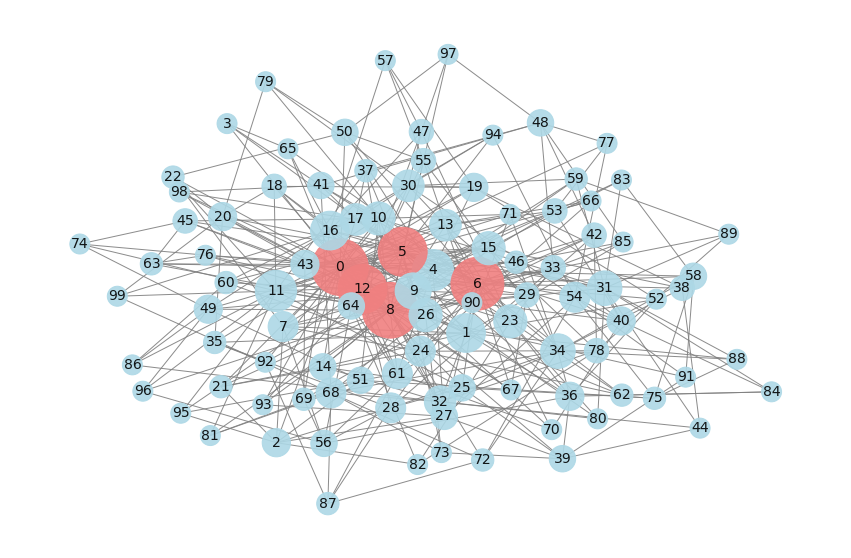

time steps =  1


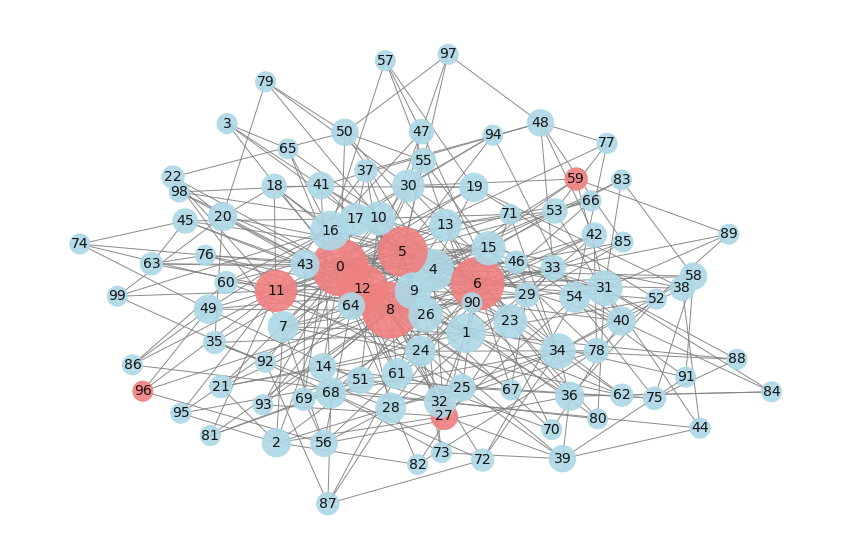

time steps =  2


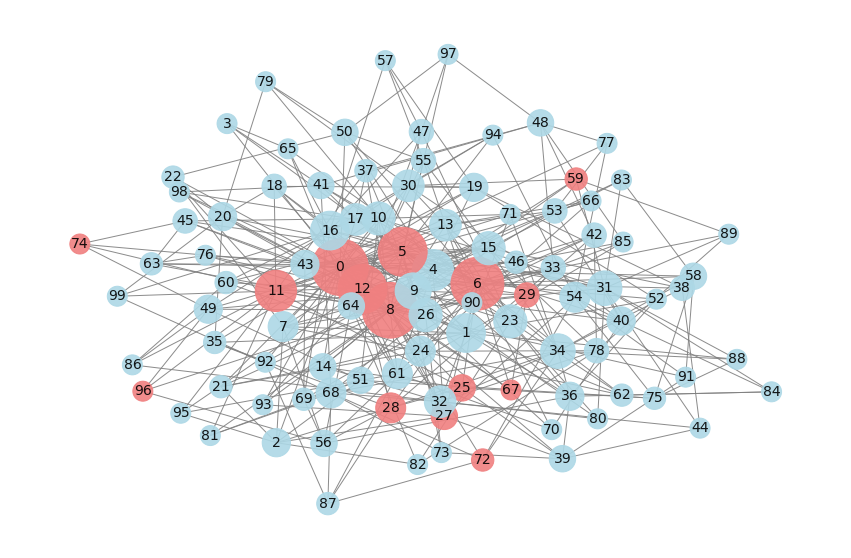

time steps =  3


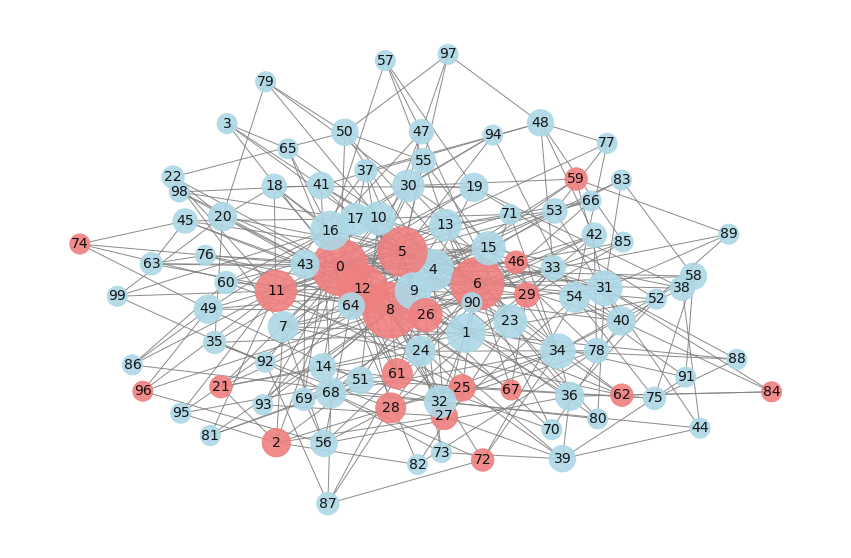

time steps =  4


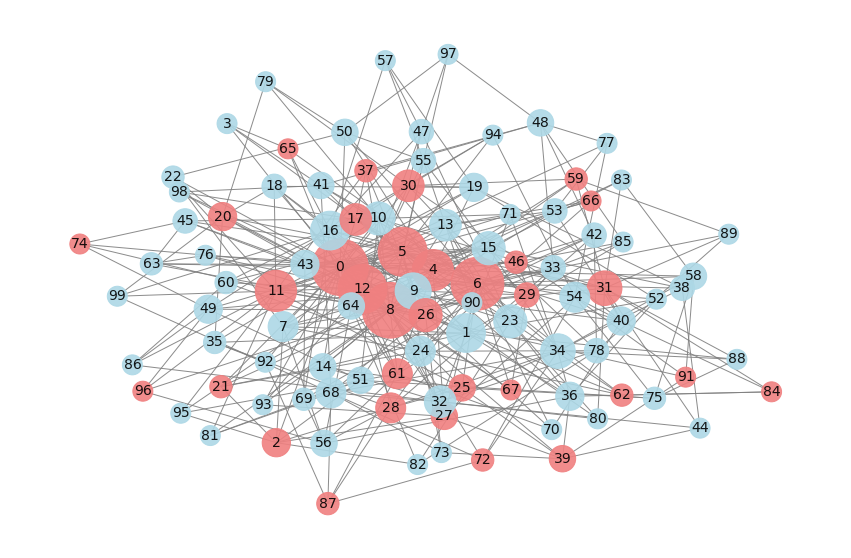

time steps =  5


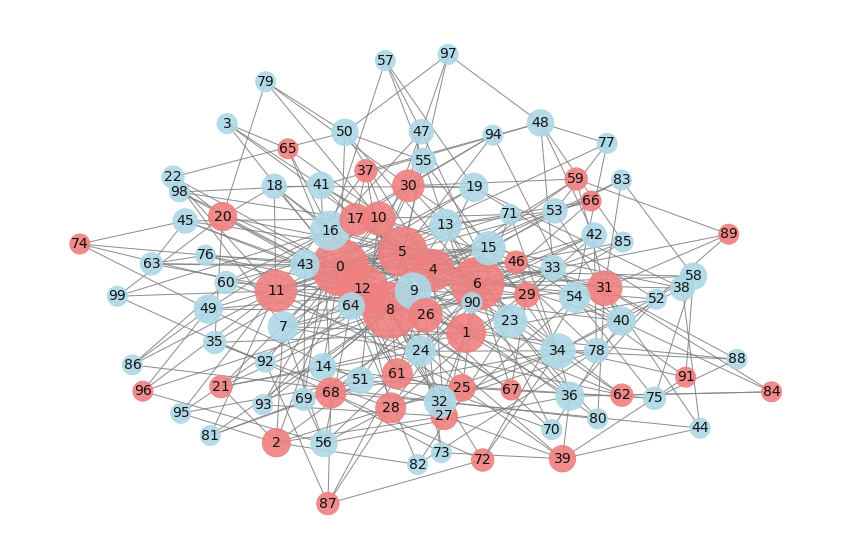

time steps =  10


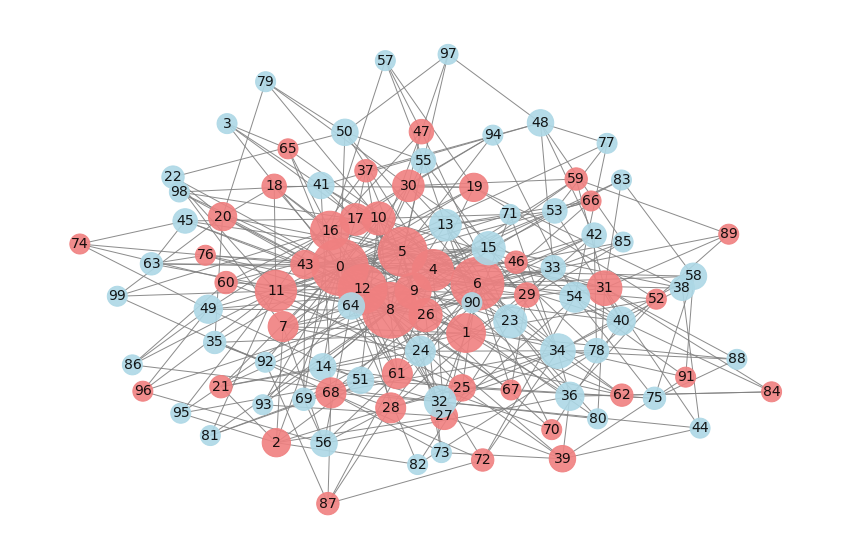

time steps =  20


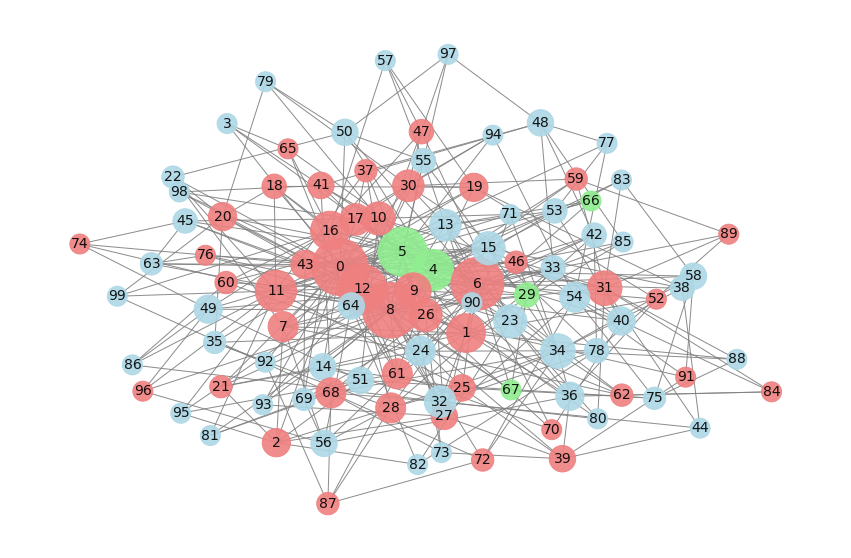

time steps =  30


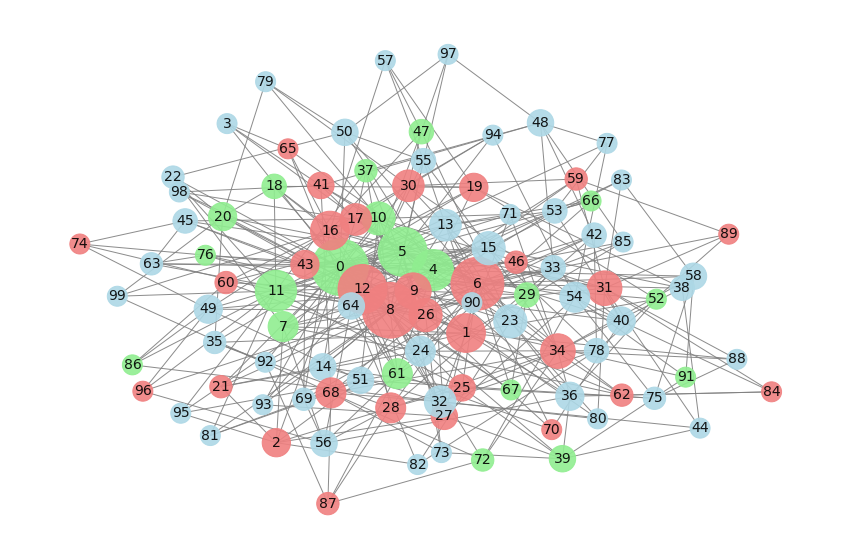

time steps =  40


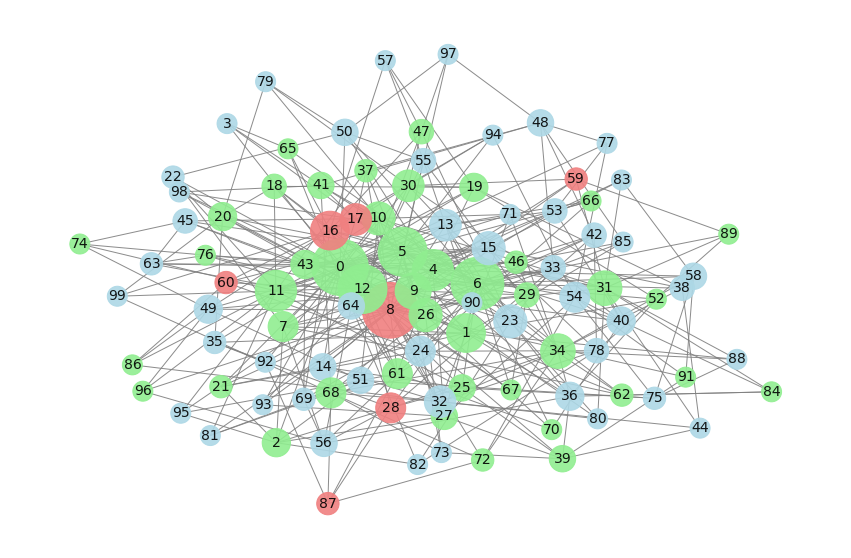

In [15]:
model = NetworkInfectionModel(no_agents, ptrans=0.05,
                              infection_period=30, 
                              infection_sd=10, seed=143,
                              m=4, target_hubs=True)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_network(model, fig,layout='spiral')
        plt.savefig(f"figures_scenario2/infperiod=30_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [16]:
describe_network(model)

Average clustering coefficient: 0.15255633804292118
Characteristic path length: 2.383232323232323


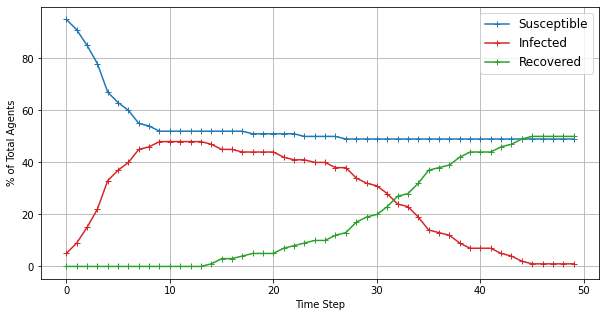

In [17]:
plot_SIR(model,no_agents,"figures_scenario2/SIR_infperiod=30")

## Making 100 simulations

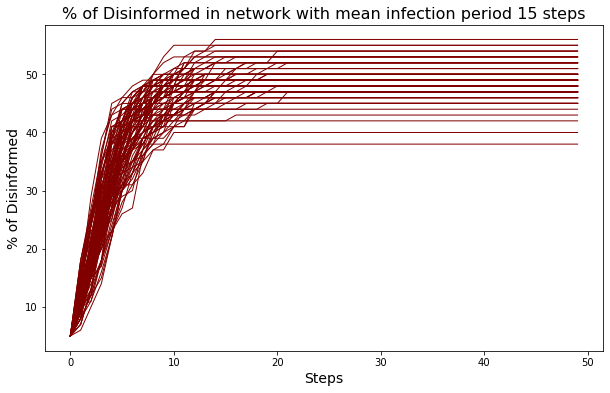

In [18]:
df_list = simulate_transimission(n_simulations=n_simulations,
                                 total_steps=total_steps,
                                 m=4, no_agents=no_agents, ptrans=0.05,
                                 infection_period=15, infection_sd=5,
                                 target_hubs=True)

plt.figure(figsize=(10,6))
for i in range(len(df_list)):
    plt.plot(df_list[i]['Step'],
             (df_list[i]['No. of Disinformed']/no_agents)*100,
              lw=1, color='maroon')
    
plt.title("% of Disinformed in network with mean infection period 15 steps",
          fontsize=16)  
plt.xlabel('Steps', fontsize=14)
plt.ylabel('% of Disinformed', fontsize=14)
plt.savefig(f"figures_scenario2/disbelievers_infperiod=15.png", dpi=300)

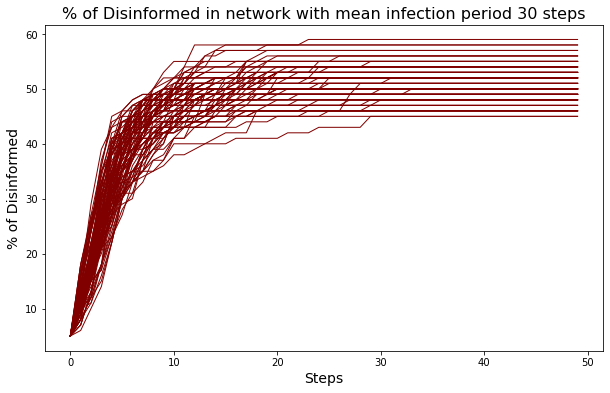

In [19]:
df_list = simulate_transimission(n_simulations=n_simulations,
                                 total_steps=total_steps,
                                 m=4, no_agents=no_agents, ptrans=0.05,
                                 infection_period=30, infection_sd=10,
                                 target_hubs=True)

plt.figure(figsize=(10,6))
for i in range(len(df_list)):
    plt.plot(df_list[i]['Step'],
             (df_list[i]['No. of Disinformed']/no_agents)*100,
              lw=1, color='maroon')
    
plt.title("% of Disinformed in network with mean infection period 30 steps",
          fontsize=16)  
plt.xlabel('Steps', fontsize=14)
plt.ylabel('% of Disinformed', fontsize=14)
plt.savefig(f"figures_scenario2/disbelievers_infperiod=30.png", dpi=300)

**Insights**
- Shorter period to spread disinformation also means it quiets down more quickly.
- Percent of Disinformation believers ranges 40%-60% at time step = 50 regardless of infection period.

# Initial infection on Random Nodes vs Hubs

The third scenario investigated the effect of changing how we select the initial spreaders – either randomly or targeting the hubs.

## Hubs as initial spreader

time steps =  0


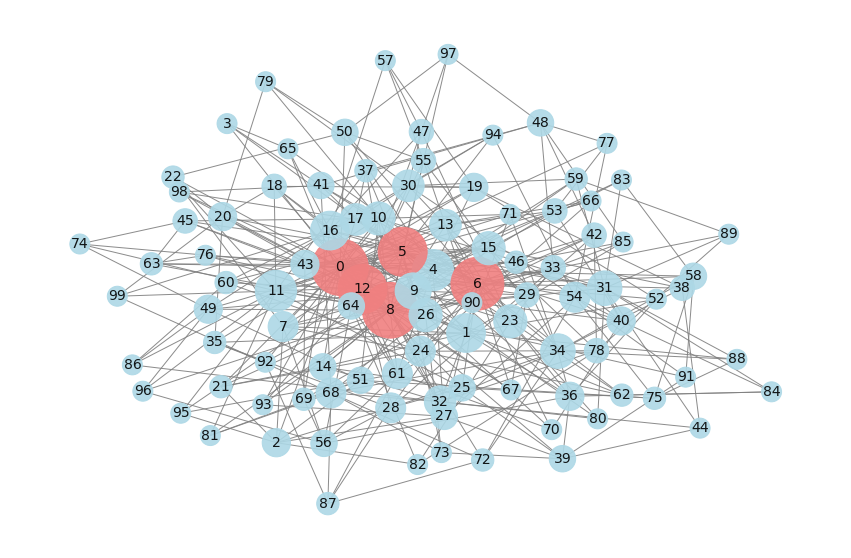

time steps =  1


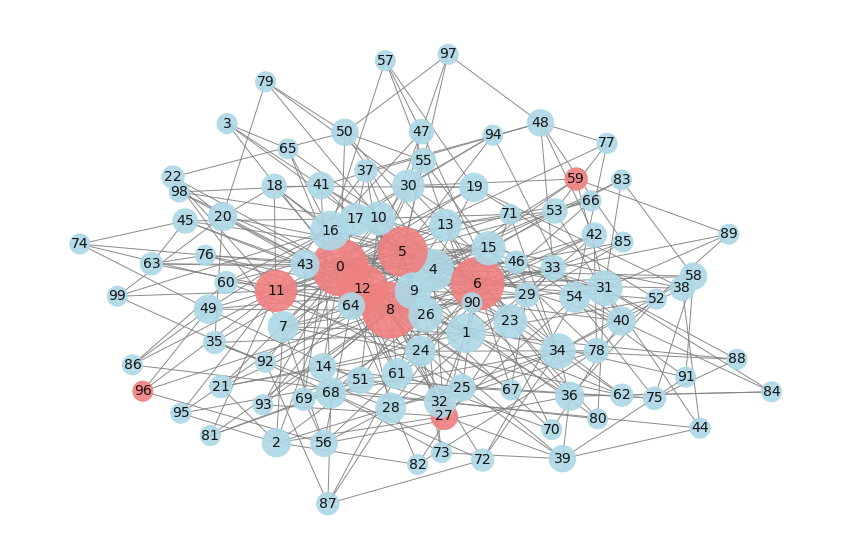

time steps =  2


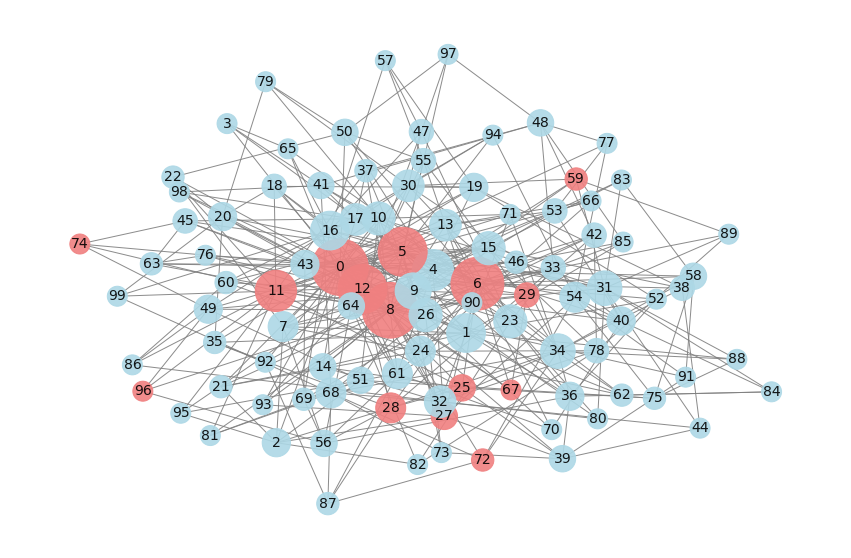

time steps =  3


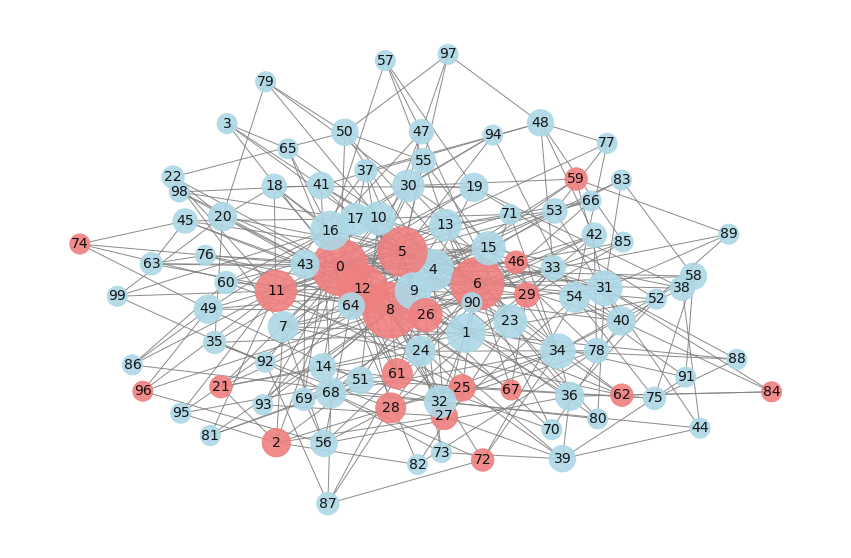

time steps =  4


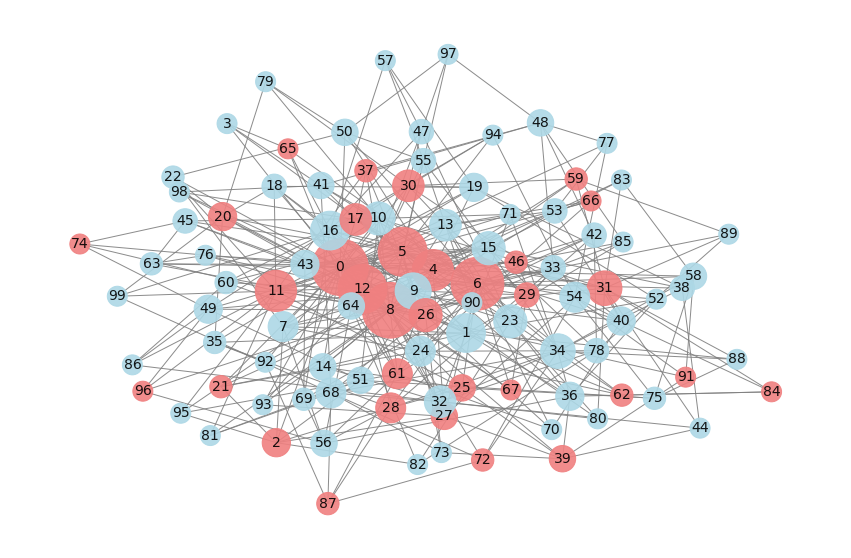

time steps =  5


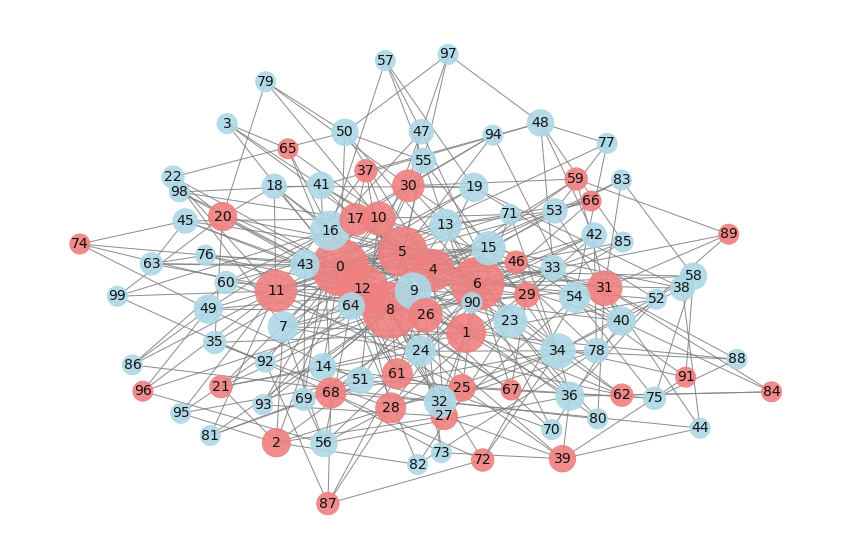

time steps =  10


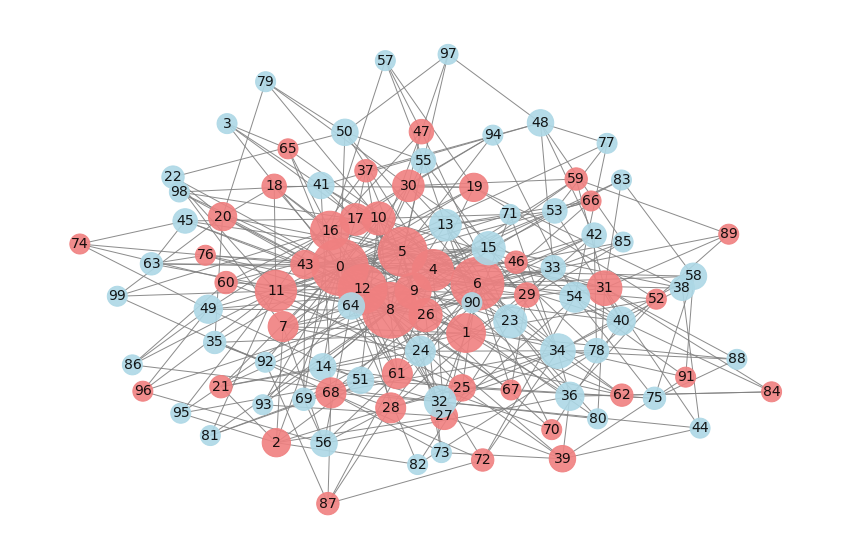

time steps =  20


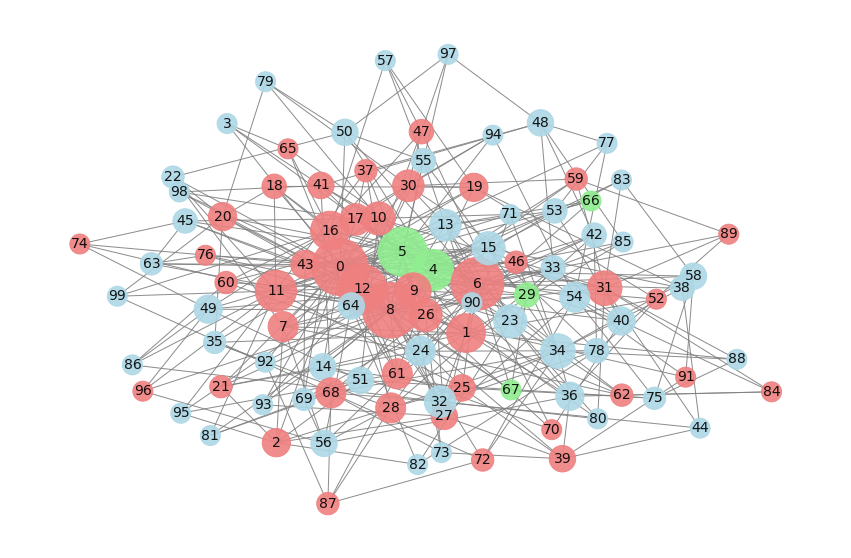

time steps =  30


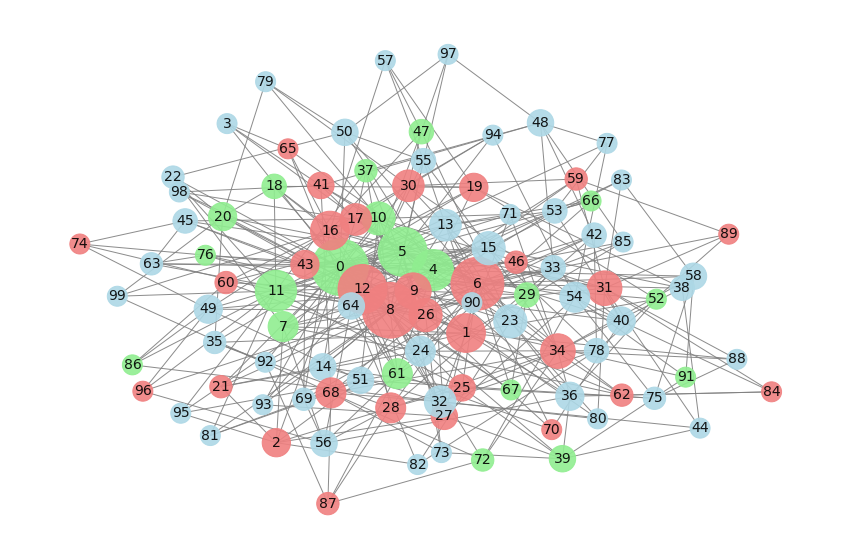

time steps =  40


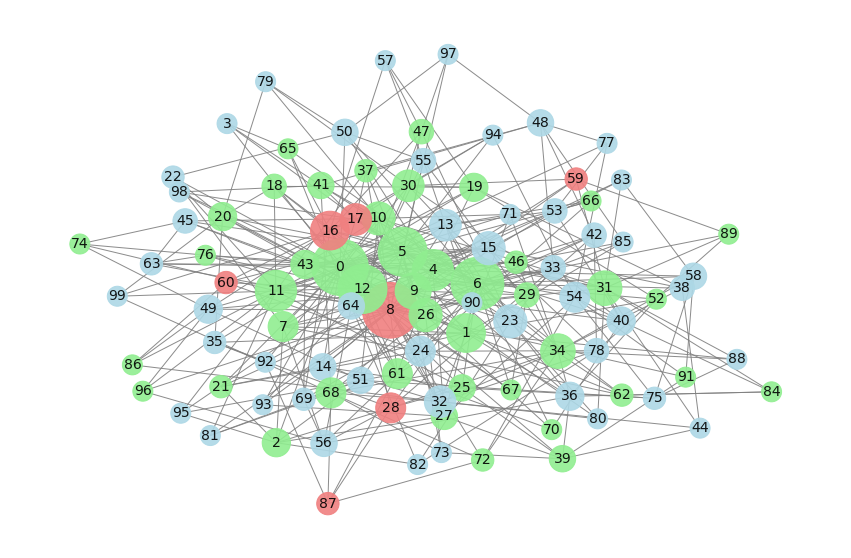

In [20]:
model = NetworkInfectionModel(no_agents, ptrans=0.05,
                              infection_period=30, 
                              infection_sd=10, seed=143,
                              m=4, target_hubs=True)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_network(model, fig,layout='spiral')
        plt.savefig(f"figures_scenario3/hubs_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [21]:
describe_network(model)

Average clustering coefficient: 0.15255633804292118
Characteristic path length: 2.383232323232323


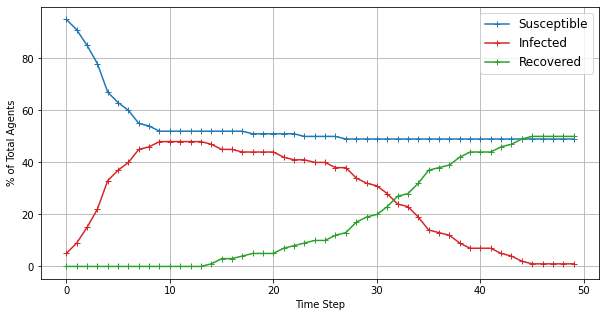

In [22]:
plot_SIR(model,no_agents,"figures_scenario3/SIR_hubs")

## Random nodes as initial spreader

time steps =  0


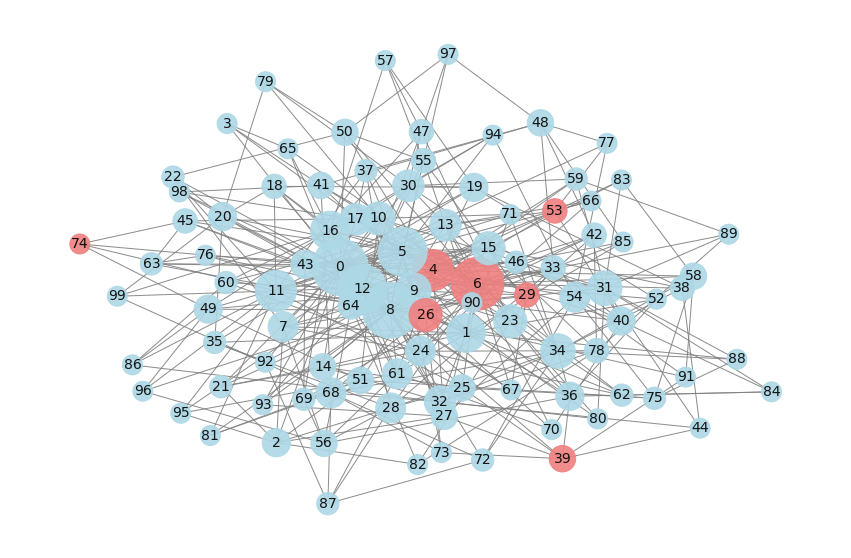

time steps =  1


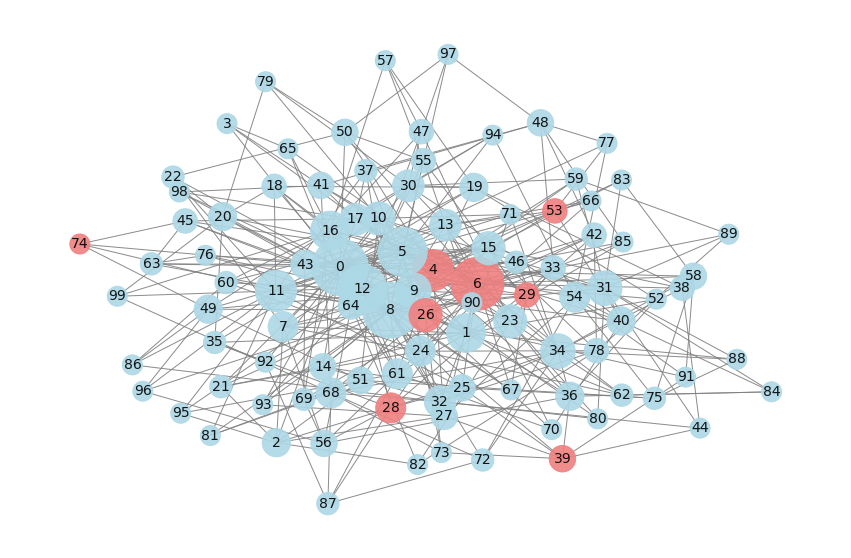

time steps =  2


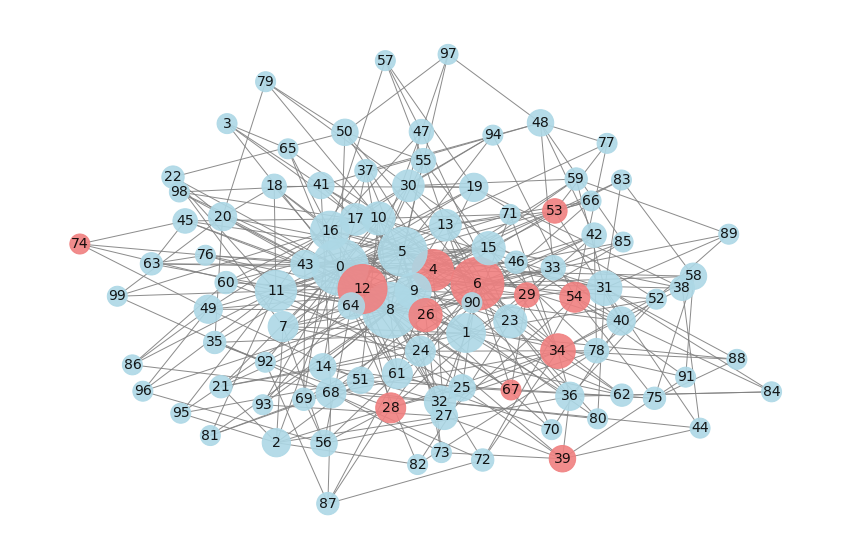

time steps =  3


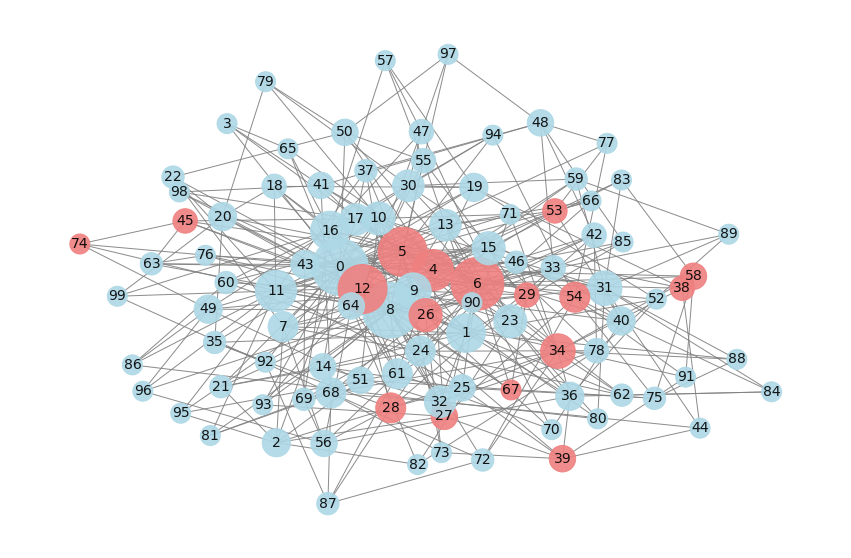

time steps =  4


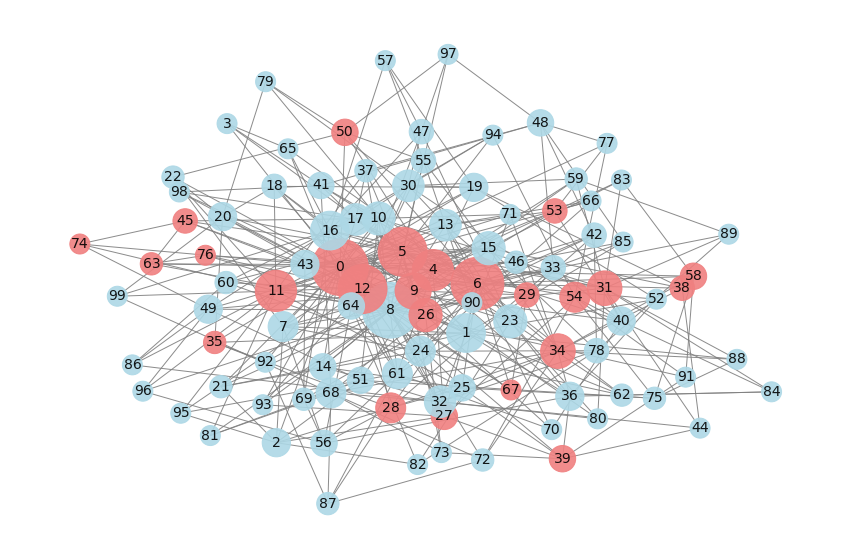

time steps =  5


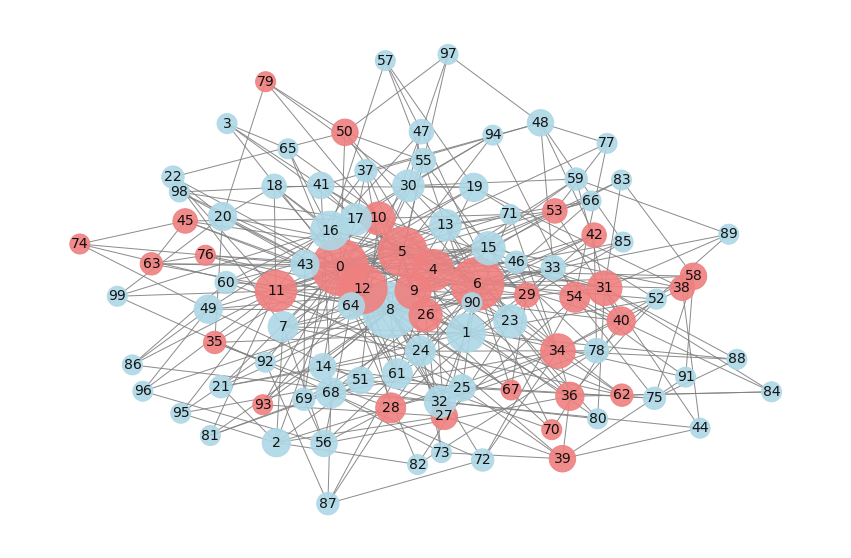

time steps =  10


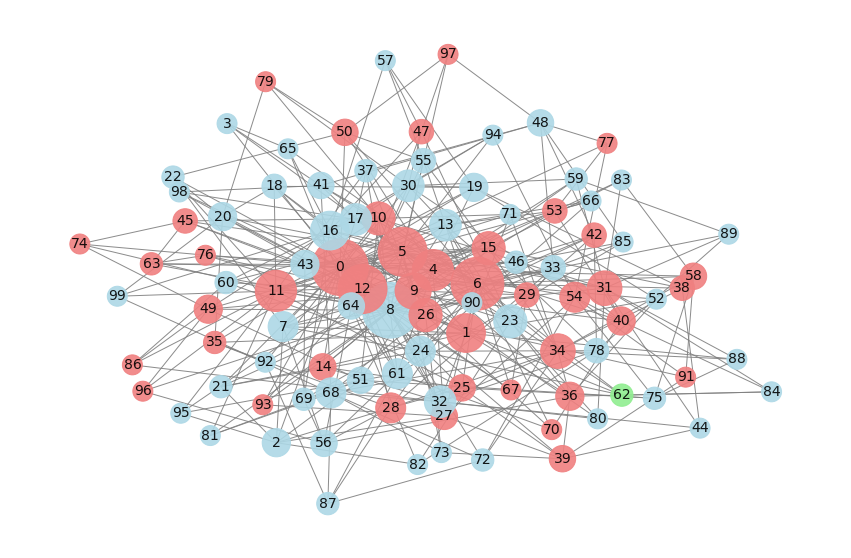

time steps =  20


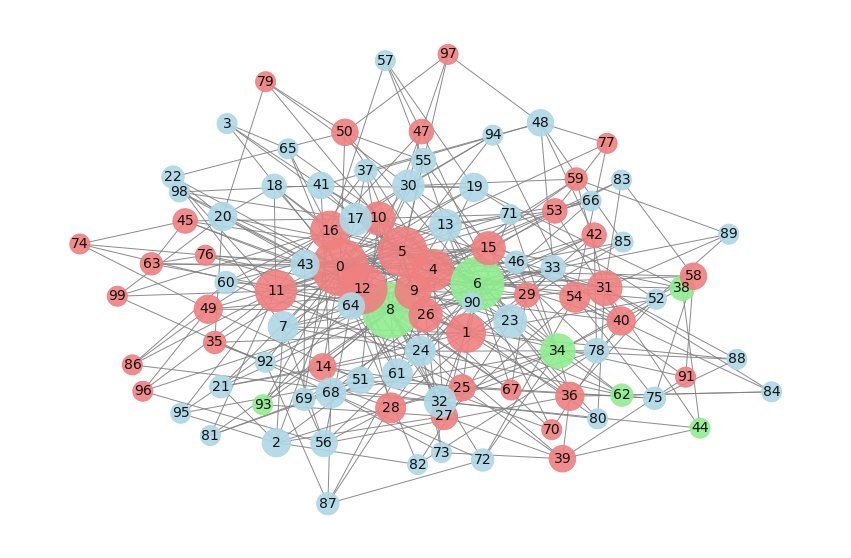

time steps =  30


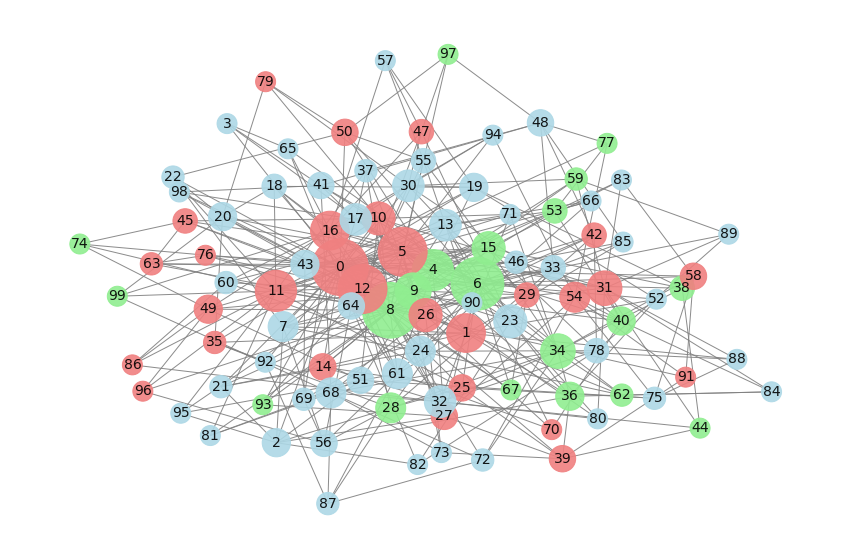

time steps =  40


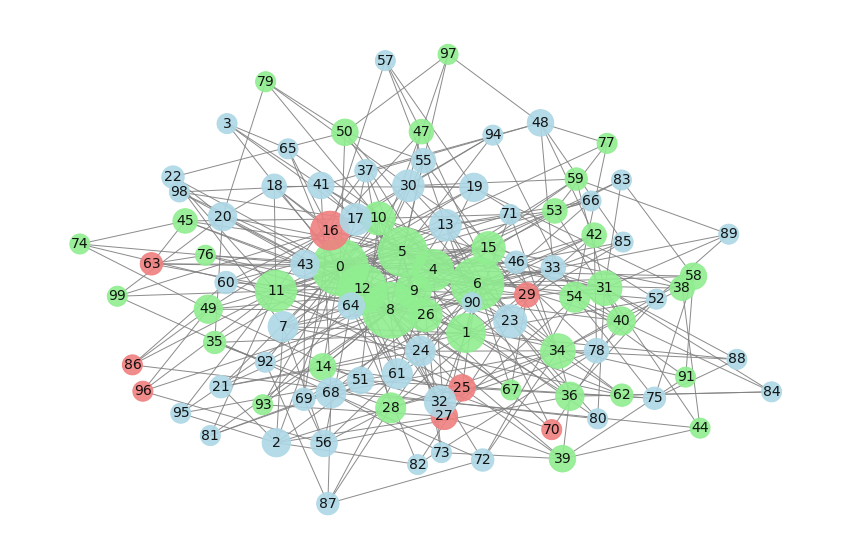

In [23]:
model = NetworkInfectionModel(no_agents, ptrans=0.05,
                              infection_period=30, 
                              infection_sd=10, seed=143,
                              m=4, target_hubs=False)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_network(model, fig,layout='spiral')
        plt.savefig(f"figures_scenario3/random_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [24]:
describe_network(model)

Average clustering coefficient: 0.15255633804292118
Characteristic path length: 2.383232323232323


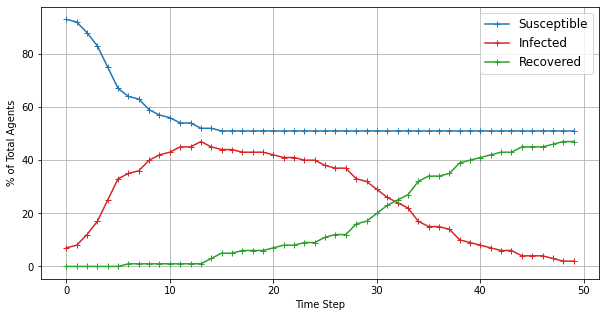

In [25]:
plot_SIR(model,no_agents,"figures_scenario3/SIR_random")

## Making 100 simulations

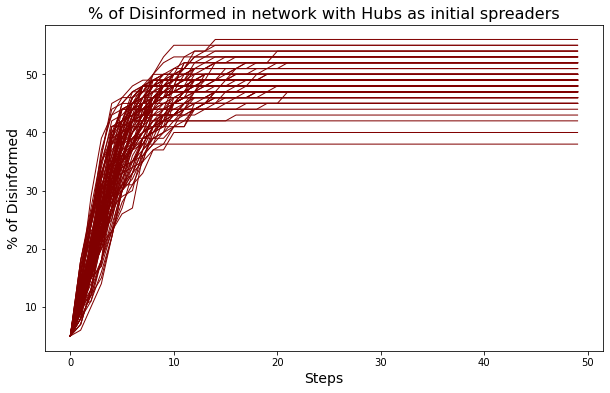

In [26]:
df_list = simulate_transimission(n_simulations=n_simulations,
                                 total_steps=total_steps,
                                 m=4, no_agents=no_agents, ptrans=0.05,
                                 infection_period=15, infection_sd=5,
                                 target_hubs=True)

plt.figure(figsize=(10,6))
for i in range(len(df_list)):
    plt.plot(df_list[i]['Step'],
             (df_list[i]['No. of Disinformed']/no_agents)*100,
              lw=1, color='maroon')
    
plt.title("% of Disinformed in network with Hubs as initial spreaders",
          fontsize=16)  
plt.xlabel('Steps', fontsize=14)
plt.ylabel('% of Disinformed', fontsize=14)
plt.savefig(f"figures_scenario3/disbelievers_hubs.png", dpi=300)

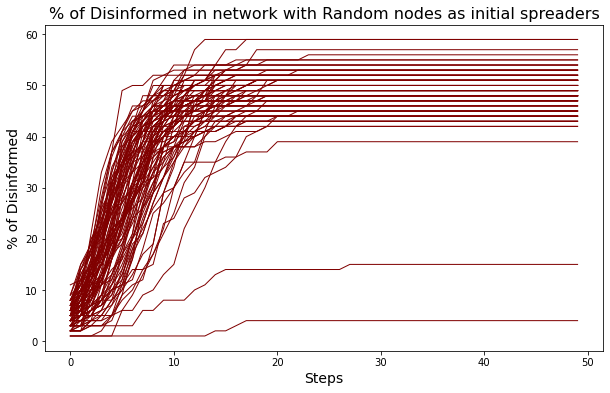

In [27]:
df_list = simulate_transimission(n_simulations=n_simulations,
                                 total_steps=total_steps,
                                 m=4, no_agents=no_agents, ptrans=0.05,
                                 infection_period=15, infection_sd=5,
                                 target_hubs=False)

plt.figure(figsize=(10,6))
for i in range(len(df_list)):
    plt.plot(df_list[i]['Step'],
             (df_list[i]['No. of Disinformed']/no_agents)*100,
              lw=1, color='maroon')
    
plt.title("% of Disinformed in network with Random nodes as initial spreaders",
          fontsize=16)  
plt.xlabel('Steps', fontsize=14)
plt.ylabel('% of Disinformed', fontsize=14)
plt.savefig(f"figures_scenario3/disbelievers_random.png", dpi=300)

**Insights**

- Targeting hubs transmit disinformation more quickly, but plateaus after certain period.
- We observed that even if we initially infect randomly, both scenarios level off and affects similar portion of agents after some time.

# Spread of Disinformation in 2 Communities

We investigated the spread of disinformation to our network with two communities, the pink on disinformed individuals, and the teal on neutral individuals. We vary transmission probabilities `ptrans` of 5% and 1%. For this scenario, we used only 50 nodes. A 70%-30% split between two communities, with the disinformed community representing 30% of the whole network.

## ptrans = 0.05

In [28]:
no_agents = 50

time steps =  0


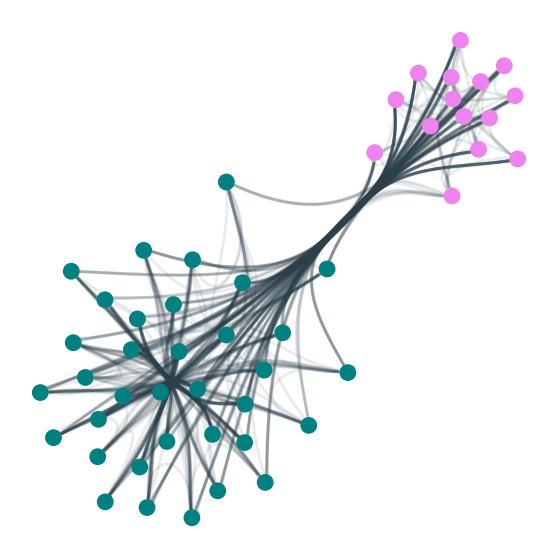

time steps =  1


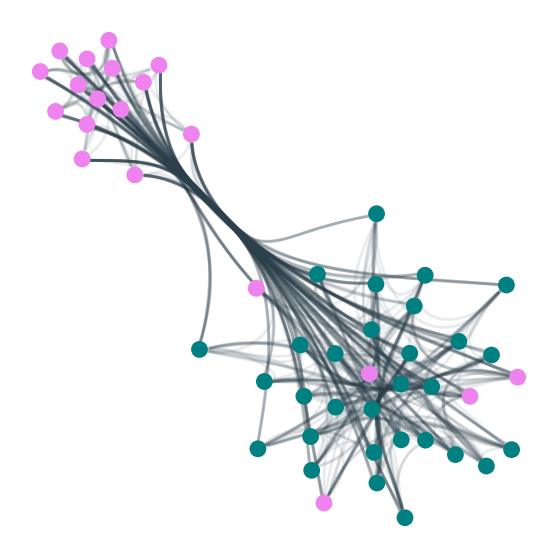

time steps =  2


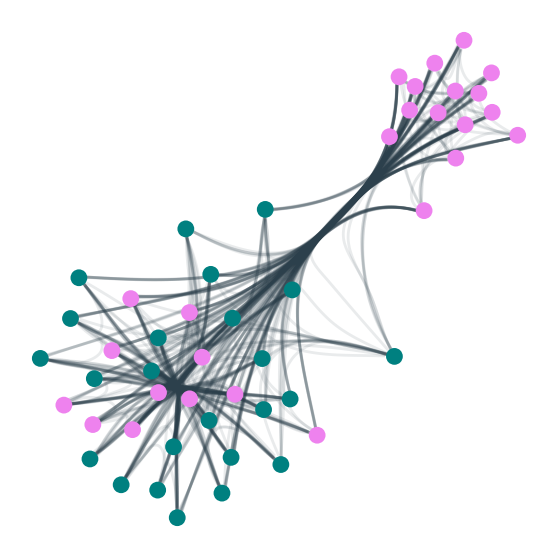

time steps =  3


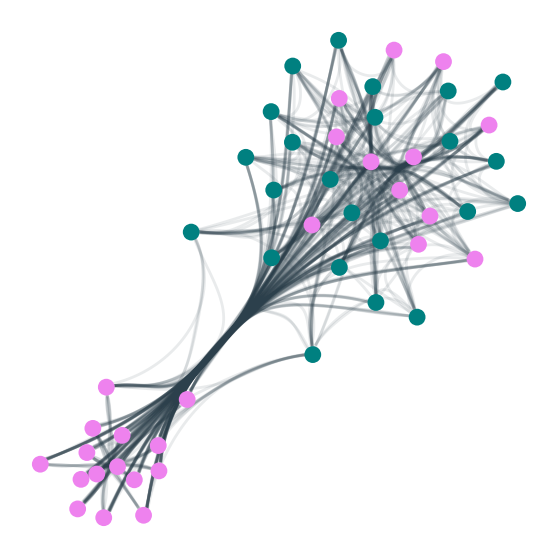

time steps =  4


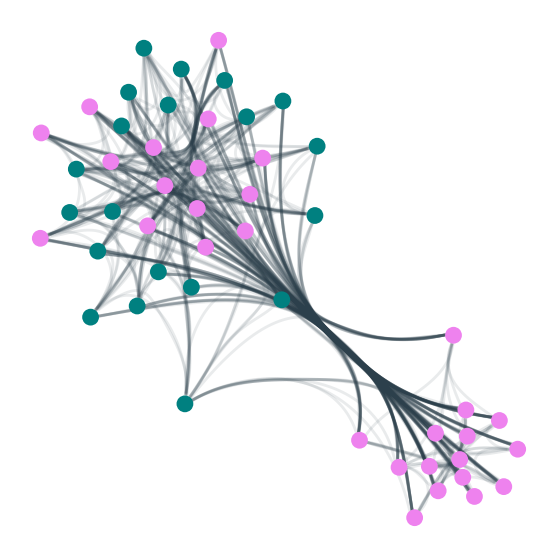

time steps =  5


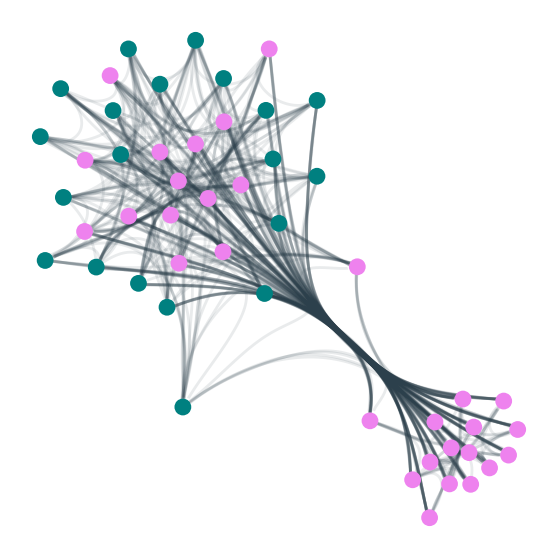

time steps =  10


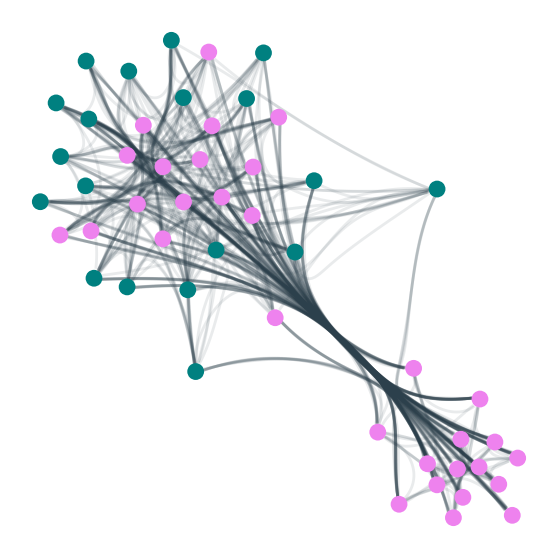

time steps =  20


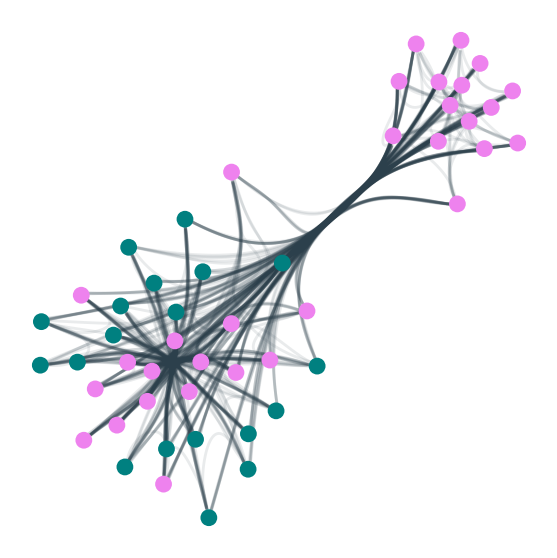

time steps =  30


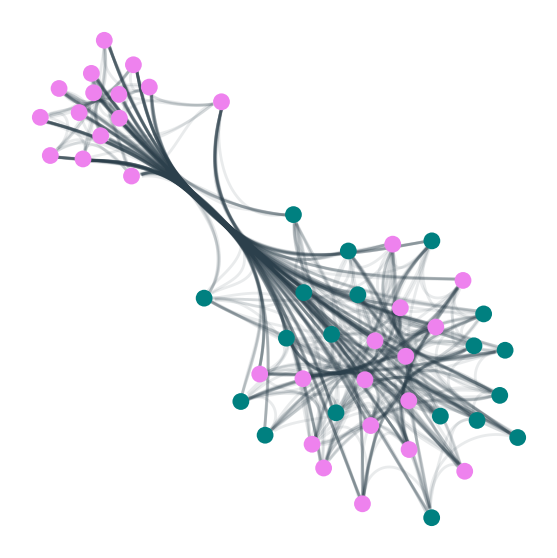

time steps =  40


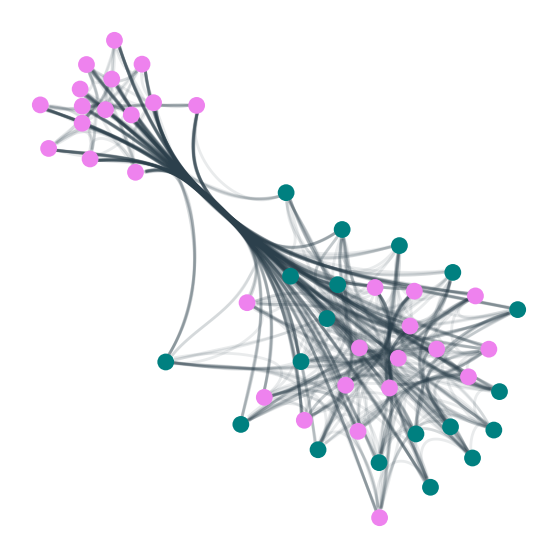

In [29]:
model = CommunityInfectionModel(no_agents, ptrans=0.05,
                                infection_period=30, infection_sd=10,
                                partition = 0.70, seed=143)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_communities(model,fig,layout='spring')
        plt.savefig(f"figures_scenario4/ptrans=0.05_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [30]:
modularity = nx_comm.modularity(model.G, model.list_nodes)

## ptrans = 0.01

time steps =  0


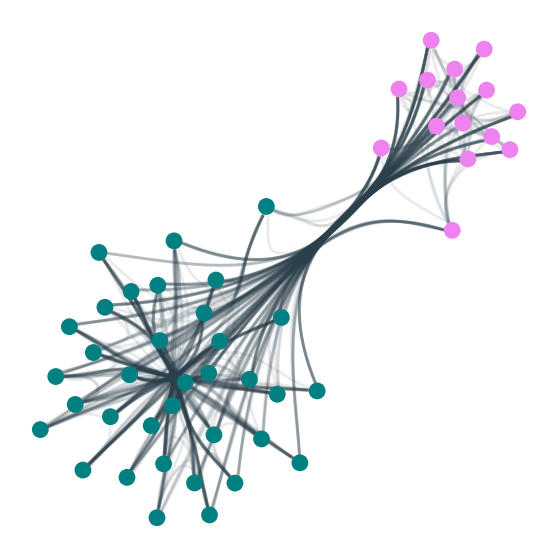

time steps =  1


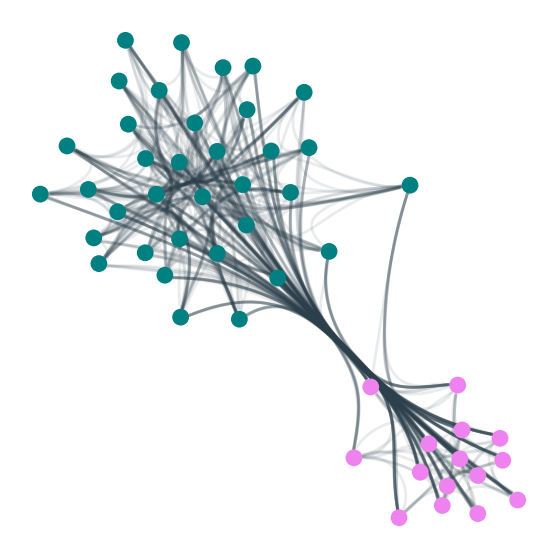

time steps =  2


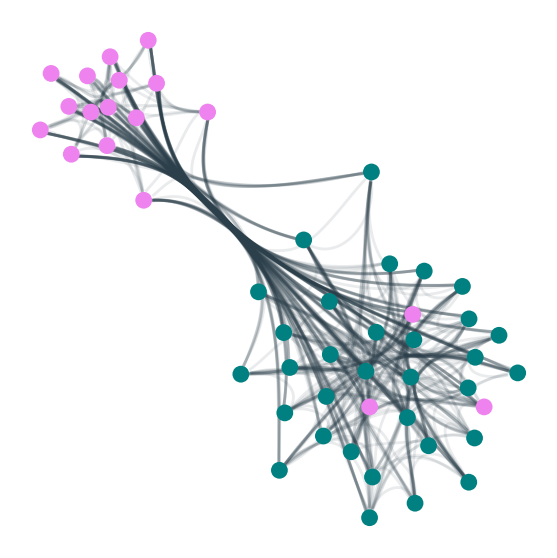

time steps =  3


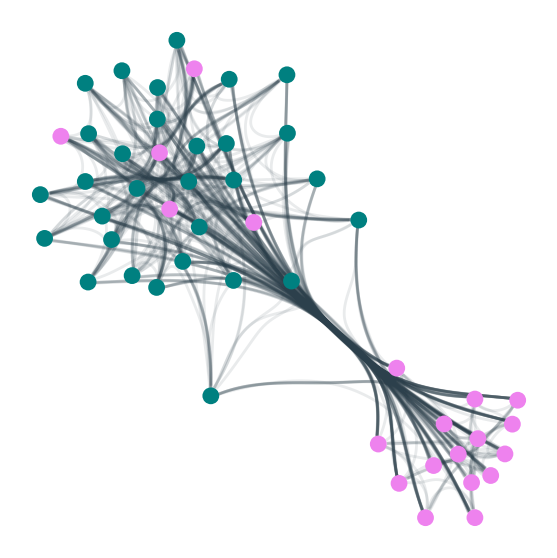

time steps =  4


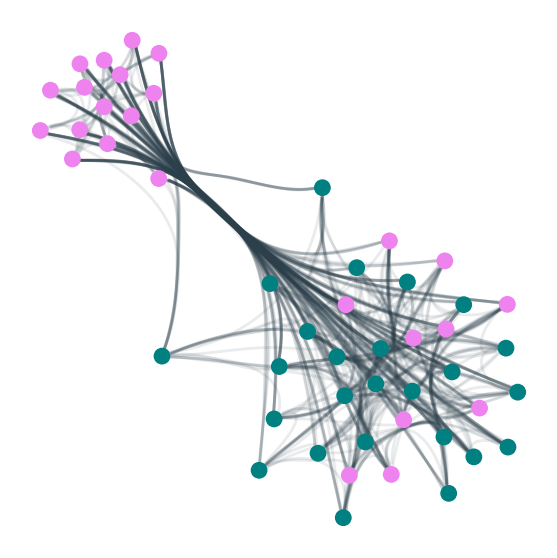

time steps =  5


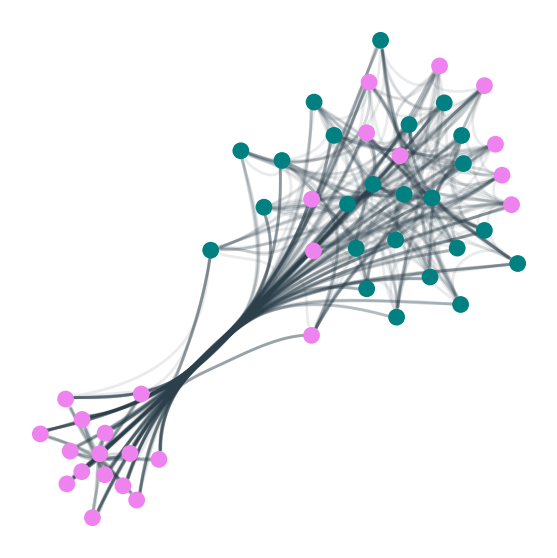

time steps =  10


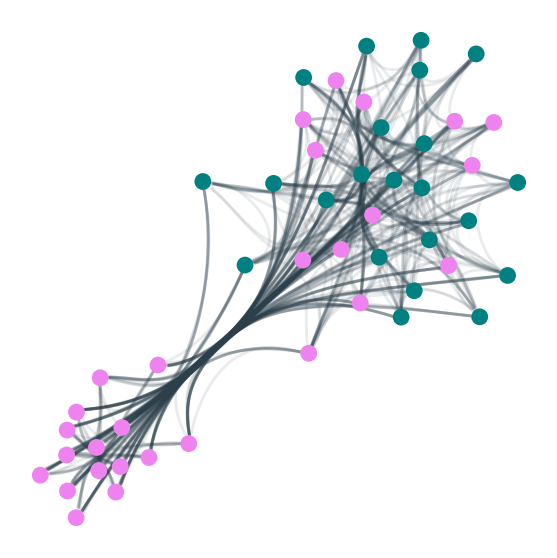

time steps =  20


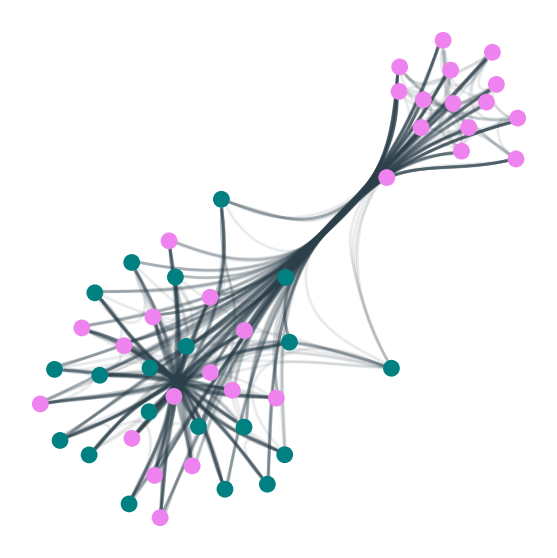

time steps =  30


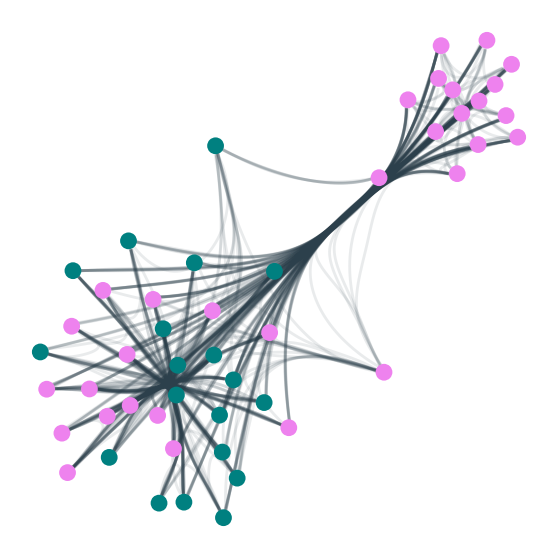

time steps =  40


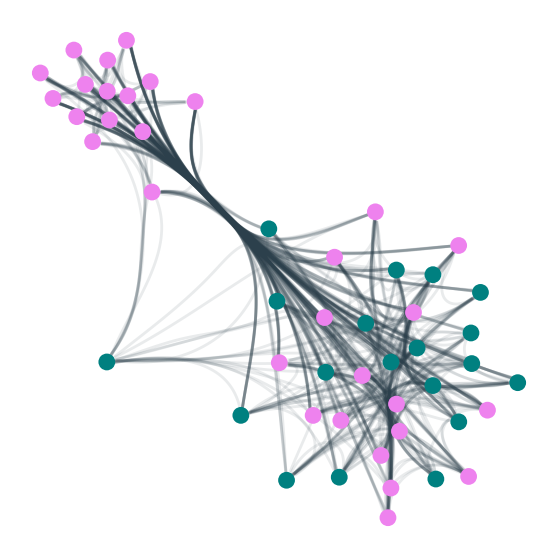

In [31]:
model = CommunityInfectionModel(no_agents, ptrans=0.01,
                                infection_period=30, infection_sd=10,
                                partition = 0.70, seed=143)
    
for i in range(total_steps):
    if (i % 10 == 0) | (i <= 5):
        fig, ax = plt.subplots(1,1, figsize=(15,10))  
        print('time steps = ', str(i))
        plot_communities(model,fig,layout='spring')
        plt.savefig(f"figures_scenario4/ptrans=0.01_step{i}.png", dpi=300)
        plt.show()
    model.step()

In [32]:
modularity = nx_comm.modularity(model.G, model.list_nodes)

## Making 100 simulations

In [33]:
no_agents = 50
df_list, modularity = simulate_community_transmission(n_simulations=n_simulations,
                                          total_steps=100,
                                          no_agents=no_agents, ptrans=0.05,
                                          infection_period= 30,
                                          infection_sd=10)

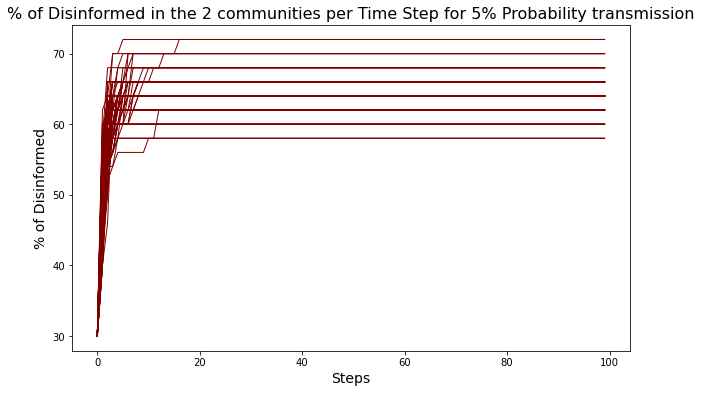

In [34]:
plt.figure(figsize=(10,6))
for i in range(len(df_list)):
    plt.plot(df_list[i]['Step'],
             (df_list[i]['No. of Disinformed']/no_agents)*100,
              lw=1, color='maroon')
plt.title('% of Disinformed in the 2 communities per Time Step for 5%'
          ' Probability transmission', fontsize=16)
plt.xlabel('Steps', fontsize=14)
plt.ylabel('% of Disinformed', fontsize=14)
plt.savefig(f"figures_scenario4/disbelievers_ptrans=0.05.png", dpi=300)

In [35]:
no_agents = 50        
df_list, modularity = simulate_community_transmission(n_simulations=n_simulations,
                                          total_steps=100,
                                          no_agents=no_agents, ptrans=0.01,
                                          infection_period= 30,
                                          infection_sd=10)

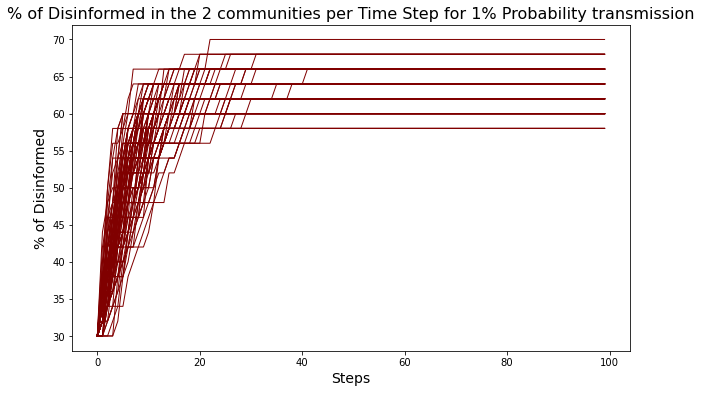

In [36]:
plt.figure(figsize=(10,6))
for i in range(len(df_list)):
    plt.plot(df_list[i]['Step'],
             (df_list[i]['No. of Disinformed']/no_agents)*100,
              lw=1, color='maroon')
plt.title('% of Disinformed in the 2 communities per Time Step for 1%'
          ' Probability transmission', fontsize=16)
plt.xlabel('Steps', fontsize=14)
plt.ylabel('% of Disinformed', fontsize=14)
plt.savefig(f"figures_scenario4/disbelievers_ptrans=0.01.png", dpi=300)

In [38]:
print(modularity)

0.043920711006519716


**Insights**
- Higher probability for transmission means faster spread of disinformation but also means faster to quiet down.
- The bridges between communities are the key to spread disinformation.
- Interestingly, it appears that regardless of the probability of transmission both simulations had almost the same number of disinformation believers at 55 to 75%.